In [ ]:
#Feature Extraction-CNN trained on Derm, feature extraction of Derm

In [ ]:
#Resnet50 and Swin Tiny Layers

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms, datasets, models
import timm
from collections import Counter
import time
import pandas as pd
from tqdm import tqdm
import os
DATASET_DIR = "/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset"
SAVE_DIR = "/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers"
BATCH_SIZE = 32
IMG_SIZE = 224

# ✅ Device configuration
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ✅ Data Transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5285, 0.3926, 0.3573], std=[0.2076, 0.1692, 0.1621])
])



# ✅ Load Dataloaders
def get_dataloaders():


    train_set = datasets.ImageFolder(os.path.join(DATASET_DIR, "train"), transform=transform)
    val_set = datasets.ImageFolder(os.path.join(DATASET_DIR, "val"), transform=transform)
    test_set = datasets.ImageFolder(os.path.join(DATASET_DIR, "test"), transform=transform)

    train_loader = DataLoader(train_set, batch_size=BATCH_SIZE, shuffle=True)
    val_loader = DataLoader(val_set, batch_size=BATCH_SIZE, shuffle=False)
    test_loader = DataLoader(test_set, batch_size=BATCH_SIZE, shuffle=False)

    return train_loader, val_loader, test_loader, len(train_set.classes)
# ✅ Get Dataloaders
train_loader, val_loader, test_loader, num_classes = get_dataloaders()


/home/pragya/.local/lib/python3.10/site-packages/torch/utils/_pytree.py:185: FutureWarning: optree is installed but the version is too old to support PyTorch Dynamo in C++ pytree. C++ pytree support is disabled. Please consider upgrading optree using `python3 -m pip install --upgrade 'optree>=0.13.0'`.
  warnings.warn(


In [6]:
import timm
import torch
import os
import numpy as np
from tqdm import tqdm

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

MODEL_PATHS = {
    'resnet50': '/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Models/resnet50.pth',
    'swin_tiny_patch4_window7_224': '/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Models/swin_tiny.pth',
}

FEATURES_DIR = "/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers"

In [18]:
def extract_features(model_name, model_path, dataloader, split):
    print(f"\n🔄 Loading fine-tuned model: {model_name}")

    # Load fine-tuned model
    model = timm.create_model(model_name, pretrained=False, num_classes=3)
    model.load_state_dict(torch.load(model_path, map_location=DEVICE))
    model.to(DEVICE)
    model.eval()
    model.reset_classifier(0)

    # Hook setup
    layer_features = {}
    hooks = []

    def get_hook(name):
        def hook(module, input, output):
            if model_name.startswith("swin") and name == "norm":
                # Mean pool across tokens: [B, num_patches, C] → [B, C]
                pooled = output.mean(dim=1)
                layer_features[name] = pooled.detach()
            else:
                layer_features[name] = output.detach()
        return hook

    # Define layers to extract from
    if model_name == "resnet50":
        target_layers = ["layer1", "layer2", "layer3", "layer4"]
    elif model_name == "swin_tiny_patch4_window7_224":
        target_layers = [
            "layers.0.blocks.0",  # Early features
            "layers.1.blocks.0",  # Mid-low
            "layers.2.blocks.0",  # Mid-high
            "layers.3.blocks.1",  # End of last stage
            "norm"                # Final Swin-Tiny features (mean pooled here)
        ]
    else:
        raise NotImplementedError(f"Layer hooks not defined for {model_name}")

    # Register hooks
    for name, module in model.named_modules():
        if name in target_layers:
            hooks.append(module.register_forward_hook(get_hook(name)))

    features_per_layer = {layer: [] for layer in target_layers}
    labels_list = []

    with torch.no_grad():
        for images, labels in tqdm(dataloader, desc=f"🔍 Extracting layer-wise {model_name} features [{split}]"):
            images = images.to(DEVICE)
            _ = model(images)  # Triggers hooks

            for layer in target_layers:
                feat = layer_features[layer]
                if feat.ndim == 4:  # For ResNet conv features
                    feat = feat.mean(dim=[2, 3])
                features_per_layer[layer].append(feat.cpu().numpy())

            labels_list.append(labels.cpu().numpy())

    # Save labels
    labels_np = np.concatenate(labels_list)
    np.save(os.path.join(FEATURES_DIR, f"{model_name}_{split}_labels.npy"), labels_np)

    # Save features per layer
    for layer in target_layers:
        features_np = np.vstack(features_per_layer[layer])
        layer_clean = layer.replace(".", "_")
        np.save(os.path.join(FEATURES_DIR, f"{model_name}_{split}_features_{layer_clean}.npy"), features_np)
        print(f"✅ Saved: {model_name} | {layer} → {features_np.shape}")

    # Clean up hooks
    for h in hooks:
        h.remove()


In [19]:
splits = {
    "train": train_loader,
    "val": val_loader,
    "test": test_loader
}

for model_name, model_path in MODEL_PATHS.items():
    for split, loader in splits.items():
        extract_features(model_name, model_path, loader, split)

print("\n🎉 Layer-wise feature extraction from fine-tuned models complete!")



🔄 Loading fine-tuned model: resnet50


🔍 Extracting layer-wise resnet50 features [train]: 100%|███████████████████████████████| 69/69 [00:20<00:00,  3.39it/s]


✅ Saved: resnet50 | layer1 → (2198, 256)
✅ Saved: resnet50 | layer2 → (2198, 512)
✅ Saved: resnet50 | layer3 → (2198, 1024)
✅ Saved: resnet50 | layer4 → (2198, 2048)

🔄 Loading fine-tuned model: resnet50


🔍 Extracting layer-wise resnet50 features [val]: 100%|███████████████████████████████████| 9/9 [00:02<00:00,  3.48it/s]


✅ Saved: resnet50 | layer1 → (275, 256)
✅ Saved: resnet50 | layer2 → (275, 512)
✅ Saved: resnet50 | layer3 → (275, 1024)
✅ Saved: resnet50 | layer4 → (275, 2048)

🔄 Loading fine-tuned model: resnet50


🔍 Extracting layer-wise resnet50 features [test]: 100%|██████████████████████████████████| 9/9 [00:02<00:00,  3.50it/s]


✅ Saved: resnet50 | layer1 → (277, 256)
✅ Saved: resnet50 | layer2 → (277, 512)
✅ Saved: resnet50 | layer3 → (277, 1024)
✅ Saved: resnet50 | layer4 → (277, 2048)

🔄 Loading fine-tuned model: swin_tiny_patch4_window7_224


🔍 Extracting layer-wise swin_tiny_patch4_window7_224 features [train]: 100%|███████████| 69/69 [00:21<00:00,  3.16it/s]


✅ Saved: swin_tiny_patch4_window7_224 | layers.0.blocks.0 → (2198, 56)
✅ Saved: swin_tiny_patch4_window7_224 | layers.1.blocks.0 → (2198, 28)
✅ Saved: swin_tiny_patch4_window7_224 | layers.2.blocks.0 → (2198, 14)
✅ Saved: swin_tiny_patch4_window7_224 | layers.3.blocks.1 → (2198, 7)
✅ Saved: swin_tiny_patch4_window7_224 | norm → (2198, 7, 768)

🔄 Loading fine-tuned model: swin_tiny_patch4_window7_224


🔍 Extracting layer-wise swin_tiny_patch4_window7_224 features [val]: 100%|███████████████| 9/9 [00:02<00:00,  3.19it/s]


✅ Saved: swin_tiny_patch4_window7_224 | layers.0.blocks.0 → (275, 56)
✅ Saved: swin_tiny_patch4_window7_224 | layers.1.blocks.0 → (275, 28)
✅ Saved: swin_tiny_patch4_window7_224 | layers.2.blocks.0 → (275, 14)
✅ Saved: swin_tiny_patch4_window7_224 | layers.3.blocks.1 → (275, 7)
✅ Saved: swin_tiny_patch4_window7_224 | norm → (275, 7, 768)

🔄 Loading fine-tuned model: swin_tiny_patch4_window7_224


🔍 Extracting layer-wise swin_tiny_patch4_window7_224 features [test]: 100%|██████████████| 9/9 [00:02<00:00,  3.21it/s]

✅ Saved: swin_tiny_patch4_window7_224 | layers.0.blocks.0 → (277, 56)
✅ Saved: swin_tiny_patch4_window7_224 | layers.1.blocks.0 → (277, 28)
✅ Saved: swin_tiny_patch4_window7_224 | layers.2.blocks.0 → (277, 14)
✅ Saved: swin_tiny_patch4_window7_224 | layers.3.blocks.1 → (277, 7)
✅ Saved: swin_tiny_patch4_window7_224 | norm → (277, 7, 768)

🎉 Layer-wise feature extraction from fine-tuned models complete!


✅ Using Font: Liberation Serif


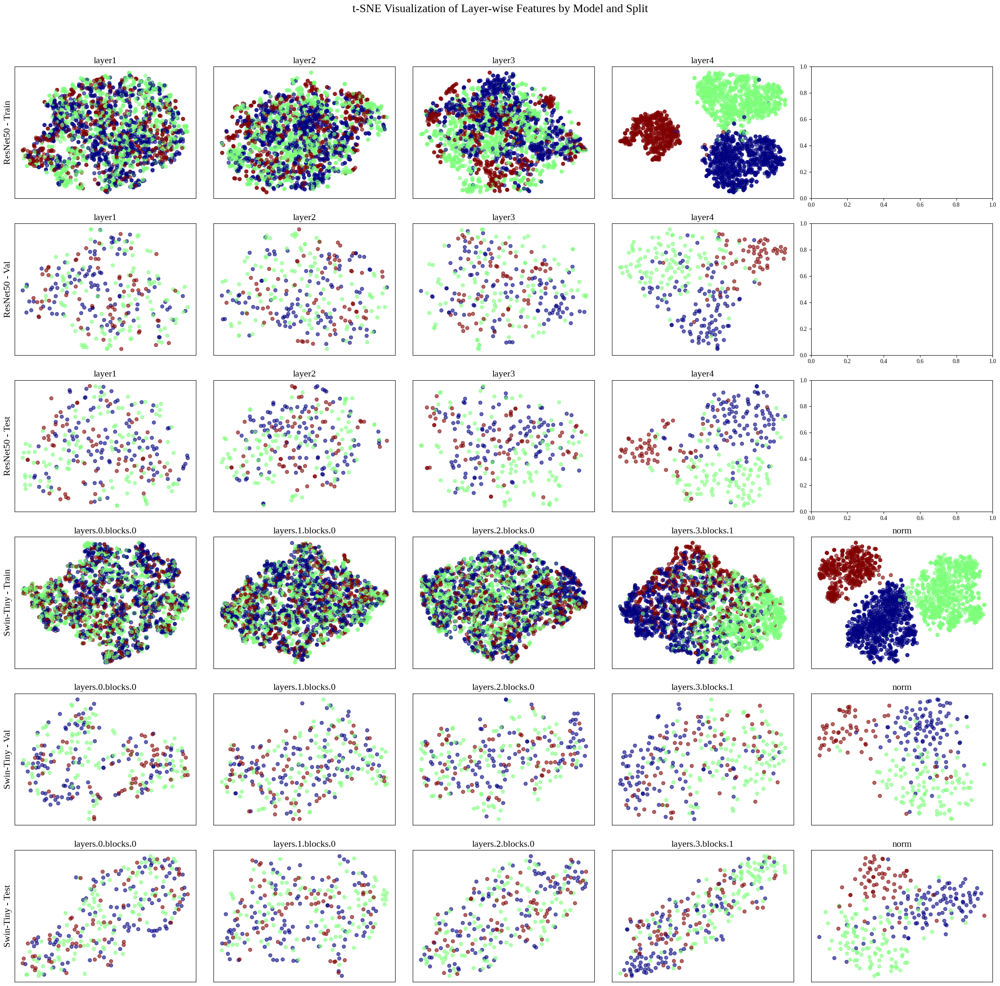

In [21]:
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from matplotlib import font_manager as fm
# ✅ Use the correct Liberation Serif font
font_path = "/usr/share/fonts/truetype/liberation/LiberationSerif-Regular.ttf"

# ✅ Force-add the font
fm.fontManager.addfont(font_path)

# ✅ Create a font properties object
liberation_font = fm.FontProperties(fname=font_path)
# ✅ Apply the font globally to all plots
plt.rcParams['font.family'] = liberation_font.get_name()
print("✅ Using Font:", liberation_font.get_name())  # Verify the font

# Example config
MODELS = ["resnet50", "swin_tiny_patch4_window7_224"]
MODEL_SHORT_NAMES = ["ResNet50", "Swin-Tiny"]
SPLITS = ["train", "val", "test"]
LAYERS = {
    "resnet50": ["layer1", "layer2", "layer3", "layer4"],
    "swin_tiny_patch4_window7_224": [
         "layers.0.blocks.0", "layers.1.blocks.0", "layers.2.blocks.0", "layers.3.blocks.1",  "norm" 
    ]
}

FEATURES_DIR = "/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers"

# === Prepare Plot ===
num_rows = len(MODELS) * len(SPLITS)
fig, axes = plt.subplots(nrows=num_rows, ncols=5, figsize=(24, 4 * num_rows))
fig.suptitle("t-SNE Visualization of Layer-wise Features by Model and Split", fontsize=20, fontweight="bold", fontproperties=liberation_font)

# === Loop Through Models and Splits ===
for m_idx, (model_name, short_name) in enumerate(zip(MODELS, MODEL_SHORT_NAMES)):
    for s_idx, split in enumerate(SPLITS):
        row = m_idx * len(SPLITS) + s_idx
        layer_names = LAYERS[model_name]

        for col, layer in enumerate(layer_names):
            ax = axes[row, col] if num_rows > 1 else axes[col]
            layer_safe = layer.replace(".", "_")

            feature_path = os.path.join(FEATURES_DIR, f"{model_name}_{split}_features_{layer_safe}.npy")
            label_path = os.path.join(FEATURES_DIR, f"{model_name}_{split}_labels.npy")

            if not os.path.exists(feature_path) or not os.path.exists(label_path):
                ax.set_title(f"Missing: {short_name}-{layer}", fontsize=10)
                ax.axis('off')
                continue

            # Load and flatten features
            features = np.load(feature_path)
            labels = np.load(label_path)
            if features.ndim > 2:
                features = features.reshape(features.shape[0], -1)

            # Apply t-SNE
            tsne = TSNE(n_components=2, random_state=42, perplexity=30)
            reduced = tsne.fit_transform(features)

            # Scatter Plot
            sc = ax.scatter(reduced[:, 0], reduced[:, 1], c=labels, cmap="jet", alpha=0.6)
            ax.set_xticks([])
            ax.set_yticks([])

            if col == 0:
                ax.set_ylabel(f"{short_name} - {split.capitalize()}", fontsize=16, fontweight="bold")

            ax.set_title(f"{layer}", fontsize=16)

# === Final Adjustments ===
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


✅ Using Font: Liberation Serif


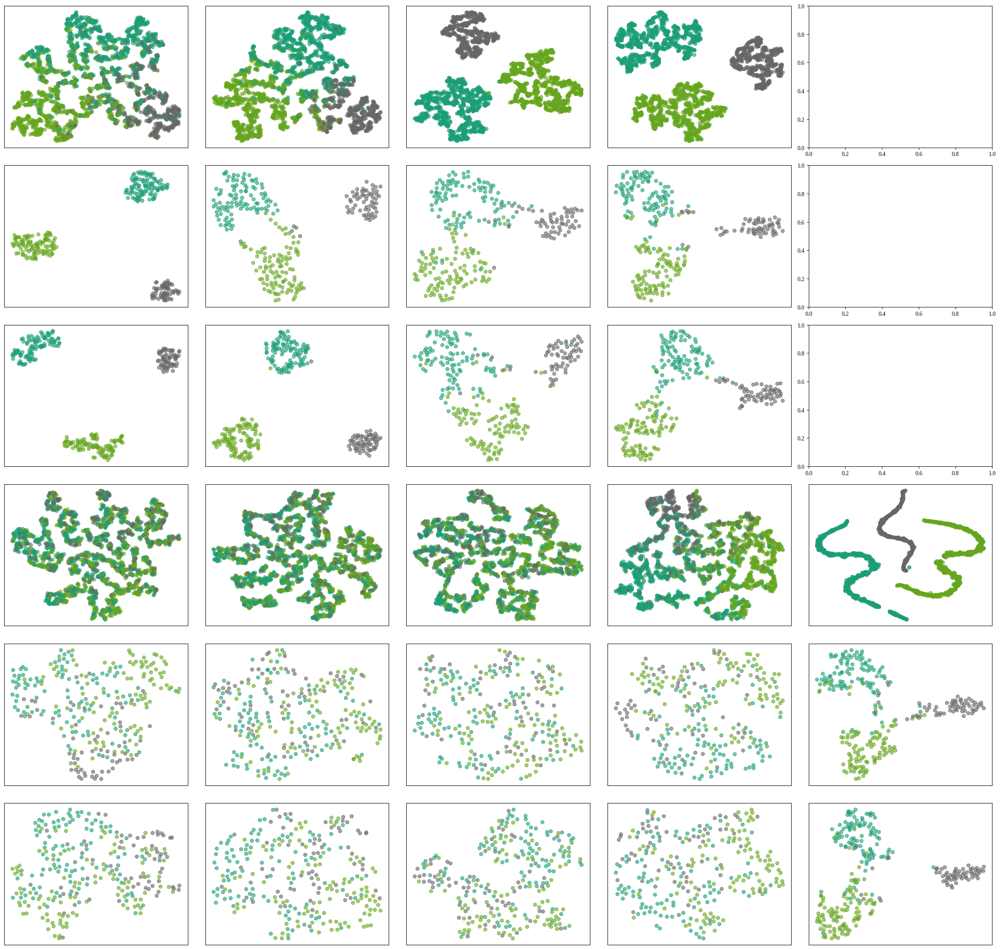

In [5]:
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from matplotlib import font_manager as fm
# ✅ Use the correct Liberation Serif font
font_path = "/usr/share/fonts/truetype/liberation/LiberationSerif-Regular.ttf"

# ✅ Force-add the font
fm.fontManager.addfont(font_path)

# ✅ Create a font properties object
liberation_font = fm.FontProperties(fname=font_path)
# ✅ Apply the font globally to all plots
plt.rcParams['font.family'] = liberation_font.get_name()
print("✅ Using Font:", liberation_font.get_name())  # Verify the font

# Example config
MODELS = ["resnet50", "swin_tiny_patch4_window7_224"]
MODEL_SHORT_NAMES = ["ResNet50", "Swin-Tiny"]
SPLITS = ["train", "val", "test"]
LAYERS = {
    "resnet50": ["layer1", "layer2", "layer3", "layer4"],
    "swin_tiny_patch4_window7_224": [
         "layers.0.blocks.0", "layers.1.blocks.0", "layers.2.blocks.0", "layers.3.blocks.1",  "norm" 
    ]
}

FEATURES_DIR = "/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers"

# === Prepare Plot ===
num_rows = len(MODELS) * len(SPLITS)
fig, axes = plt.subplots(nrows=num_rows, ncols=5, figsize=(24, 4 * num_rows))


# === Loop Through Models and Splits ===
for m_idx, (model_name, short_name) in enumerate(zip(MODELS, MODEL_SHORT_NAMES)):
    for s_idx, split in enumerate(SPLITS):
        row = m_idx * len(SPLITS) + s_idx
        layer_names = LAYERS[model_name]

        for col, layer in enumerate(layer_names):
            ax = axes[row, col] if num_rows > 1 else axes[col]
            layer_safe = layer.replace(".", "_")

            feature_path = os.path.join(FEATURES_DIR, f"{model_name}_{split}_features_{layer_safe}.npy")
            label_path = os.path.join(FEATURES_DIR, f"{model_name}_{split}_labels.npy")

            if not os.path.exists(feature_path) or not os.path.exists(label_path):
                ax.set_title(f"Missing: {short_name}-{layer}", fontsize=10)
                ax.axis('off')
                continue

            # Load and flatten features
            features = np.load(feature_path)
            labels = np.load(label_path)
            if features.ndim > 2:
                features = features.reshape(features.shape[0], -1)
            # LDA reduction (only if there are more samples than classes)
            num_classes = np.unique(labels).shape[0]
            if features.shape[0] > num_classes:
                lda = LinearDiscriminantAnalysis(n_components=min(num_classes - 1, features.shape[1]))
                features = lda.fit_transform(features, labels)
            # Apply t-SNE
            tsne = TSNE(n_components=2, random_state=42, perplexity=30)
            reduced = tsne.fit_transform(features)

            # Scatter Plot
            sc = ax.scatter(reduced[:, 0], reduced[:, 1], c=labels, cmap="Dark2", alpha=0.6)
            ax.set_xticks([])
            ax.set_yticks([])



# === Final Adjustments ===
plt.tight_layout(rect=[0, 0, 1, 0.95]) 
plt.show()


In [9]:
import os
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE, SelectKBest, f_classif, chi2
from sklearn.preprocessing import MinMaxScaler
from scipy.stats import kruskal
from boruta import BorutaPy
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib import font_manager as fm
# ✅ Use the correct Liberation Serif font
font_path = "/usr/share/fonts/truetype/liberation/LiberationSerif-Regular.ttf"

# ✅ Force-add the font
fm.fontManager.addfont(font_path)

# ✅ Create a font properties object
liberation_font = fm.FontProperties(fname=font_path)
# ✅ Apply the font globally to all plots
plt.rcParams['font.family'] = liberation_font.get_name()
print("✅ Using Font:", liberation_font.get_name())  # Verify the font

# Define all your models here (you can add layer names too)
MODELS = ["resnet50", "swin_tiny_patch4_window7_224"]
MODEL_SHORT_NAMES = ["ResNet50", "Swin-Tiny"]
SPLITS = ["train", "val", "test"]
LAYERS = {
    "resnet50": ["layer1", "layer2", "layer3", "layer4"],
    "swin_tiny_patch4_window7_224": [
         "layers.0.blocks.0", "layers.1.blocks.0", "layers.2.blocks.0", "layers.3.blocks.1",  "norm" 
    ]
}



METHODS = ["Boruta", "RFE", "ANOVA", "Chi-Square", "Kruskal-Wallis"]
FEATURES_DIR = "/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers"

# ✅ Load Features & Labels
def load_features_and_labels():
    features = {split: {} for split in SPLITS}
    labels = {"train": {}}

    for model, layers in MODELS.items():
        for split in SPLITS:
            features[split][model] = {}
            for layer in layers:
                file_path = os.path.join(FEATURES_DIR, f"{model}_{split}_features_{layer}.npy")
                features_np = np.load(file_path)

                # Normalize shape: ensure (N, C) format
                if features_np.ndim == 4:
                    if model in ["efficientnet_b0", "resnet50", "convnext_tiny"]:
                        features_np = features_np.mean(axis=(2, 3))  # (N, C)
                elif features_np.ndim == 3:
                    if model.startswith("swin") or model.startswith("vit"):
                        features_np = features_np.mean(axis=1)  # (N, C)

                features[split][model][layer] = features_np

            if split == "train":
                labels["train"][model] = np.load(os.path.join(FEATURES_DIR, f"{model}_{split}_labels.npy"))

    return features, labels


# Define your feature selection functions
def boruta_selection(X, y):
    rf = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5)
    rf.fit(X, y)
    importances = rf.feature_importances_
    mask = importances > np.mean(importances)
    return X[:, mask], mask

def rfe_selection(X, y, num_features=50):
    rf = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5)
    selector = RFE(rf, n_features_to_select=min(num_features, X.shape[1]), step=1)
    selector = selector.fit(X, y)
    return X[:, selector.support_], selector.support_

def anova_selection(X, y, k=50):
    selector = SelectKBest(score_func=f_classif, k=min(k, X.shape[1]))
    selector.fit(X, y)
    return X[:, selector.get_support()], selector.get_support()

def chi2_selection(X, y, k=50):
    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(X)  # Ensures non-negative inputs
    selector = SelectKBest(score_func=chi2, k=min(k, X.shape[1]))
    selector.fit(X_scaled, y)
    return X_scaled[:, selector.get_support()], selector.get_support()

def kruskal_selection(X, y, top_k=50):
    scores = []
    for i in range(X.shape[1]):
        groups = [X[y == label, i] for label in np.unique(y)]
        try:
            stat, p = kruskal(*groups)
        except:
            p = 1.0  # fallback if Kruskal fails
        scores.append(p)
    scores = np.array(scores)
    selected_idx = np.argsort(scores)[:min(top_k, X.shape[1])]
    mask = np.zeros(X.shape[1], dtype=bool)
    mask[selected_idx] = True
    return X[:, mask], mask

# Mapping method names to functions
FEATURE_SELECTION_METHODS = {
    "Boruta": boruta_selection,
    "RFE": rfe_selection,
    "ANOVA": anova_selection,
    "Chi-Square": chi2_selection,
    "Kruskal-Wallis": kruskal_selection
}

MODELS = {
    "resnet50": ["layer1", "layer2", "layer3", "layer4"],
    "swin_tiny_patch4_window7_224": ["layers_0_blocks_0", "layers_1_blocks_0", "layers_2_blocks_0", "layers_3_blocks_1", "norm"]
}
SPLITS = ["train", "val", "test"]
METHODS = ["Boruta", "RFE", "ANOVA", "Chi-Square", "Kruskal-Wallis"]

def apply_feature_selection(features, labels):
    selected = {}
    for model, layers in MODELS.items():
        selected[model] = {}
        for layer in layers:
            print(f"Processing {model} - {layer}")
            X_train = features["train"][model][layer]
            y_train = labels["train"][model]
            method_masks = {
                method: FEATURE_SELECTION_METHODS[method](X_train, y_train)[1]
                for method in METHODS
            }

            selected[model][layer] = {}
            for method in METHODS:
                mask = method_masks[method]
                selected[model][layer][method] = {}
                for split in SPLITS:
                    X_split = features[split][model][layer]
                    selected[model][layer][method][split] = X_split[:, mask]
    return selected
# ✅ Save selected features
def save_selected_features(selected_features):
    for model in selected_features:
        for layer in selected_features[model]:
            for method in selected_features[model][layer]:
                for split in selected_features[model][layer][method]:
                    X_selected = selected_features[model][layer][method][split]
                    save_path = os.path.join(FEATURES_DIR, f"{model}_{split}_{layer}_{method}.npy")
                    np.save(save_path, X_selected)
                    print(f"💾 Saved: {save_path}")

# ✅ Plot t-SNE
def plot_tsne(selected_features, labels):
    for split in SPLITS:
        fig, axes = plt.subplots(nrows=len(MODELS), ncols=len(METHODS), figsize=(18, 15))

        for row_idx, model in enumerate(MODELS):
            for col_idx, method in enumerate(METHODS):
                ax = axes[row_idx, col_idx]
                try:
                    layer = list(MODELS[model])[-1]  # Plot for the final layer
                    X_selected = selected_features[model][layer][method][split]

                    if X_selected.ndim > 2:
                        X_selected = X_selected.reshape(X_selected.shape[0], -1)

                    if split == "train":
                        y_labels = labels["train"][model]
                    else:
                        y_labels = np.zeros(X_selected.shape[0])

                    tsne = TSNE(n_components=2, random_state=42, perplexity=30)
                    X_embedded = tsne.fit_transform(X_selected)

                    scatter = ax.scatter(X_embedded[:, 0], X_embedded[:, 1], c=y_labels, cmap='viridis', alpha=0.6)
                    ax.set_xticks([])
                    ax.set_yticks([])
                    ax.set_title(f"{model}\n{method}", fontproperties=liberation_font, fontsize=8)

                except Exception as e:
                    ax.set_title(f"Error: {model} - {method}", fontsize=8)
                    ax.text(0.5, 0.5, str(e), ha='center', va='center', fontsize=6)
                    ax.set_xticks([])
                    ax.set_yticks([])

        fig.suptitle(f"t-SNE Visualization for {split.capitalize()} Set", fontproperties=liberation_font, fontsize=16)
        fig.colorbar(scatter, ax=axes.ravel().tolist())
        plt.tight_layout()
        plt.show()

  


✅ Using Font: Liberation Serif


Processing resnet50 - layer1
Processing resnet50 - layer2
Processing resnet50 - layer3
Processing resnet50 - layer4
Processing swin_tiny_patch4_window7_224 - layers_0_blocks_0
Processing swin_tiny_patch4_window7_224 - layers_1_blocks_0
Processing swin_tiny_patch4_window7_224 - layers_2_blocks_0
Processing swin_tiny_patch4_window7_224 - layers_3_blocks_1
Processing swin_tiny_patch4_window7_224 - norm
💾 Saved: /mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers/resnet50_train_layer1_Boruta.npy
💾 Saved: /mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers/resnet50_val_layer1_Boruta.npy
💾 Saved: /mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers/resnet50_test_layer1_Boruta.npy
💾 Saved: /mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers/resnet50_train_layer1_RFE.npy
💾 Saved: /mnt/c/Users/pragy/Downloads/Dataset/Origi

/tmp/ipykernel_239606/3076532915.py:192: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


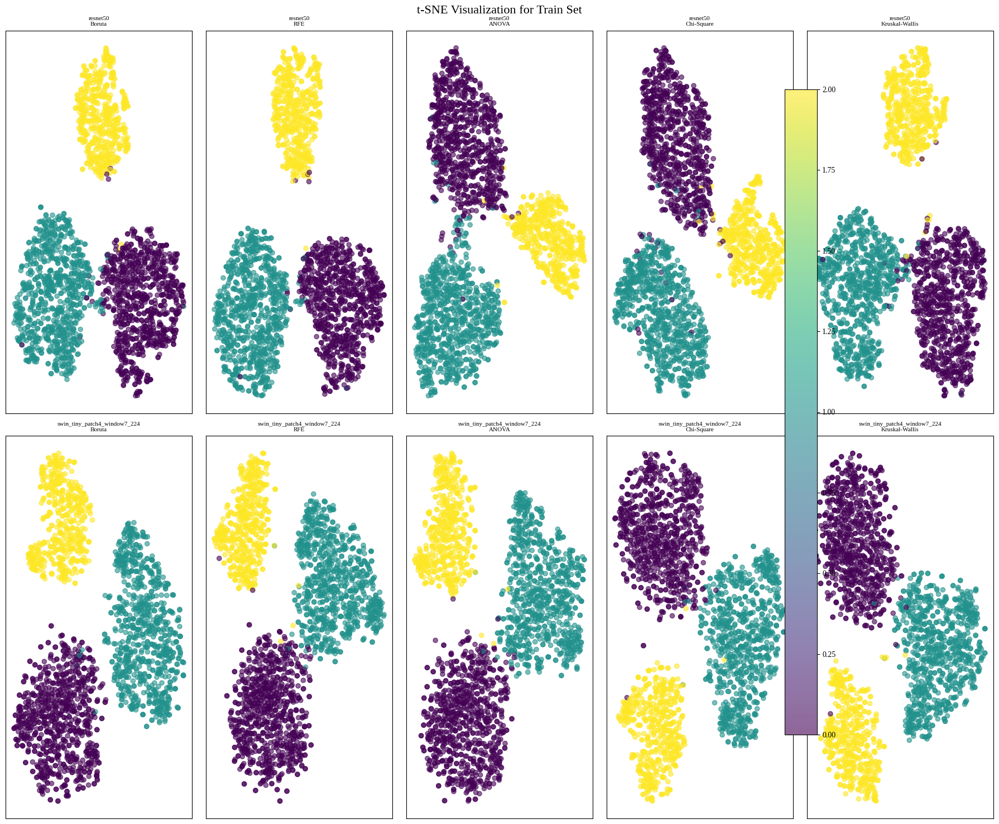

/tmp/ipykernel_239606/3076532915.py:192: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


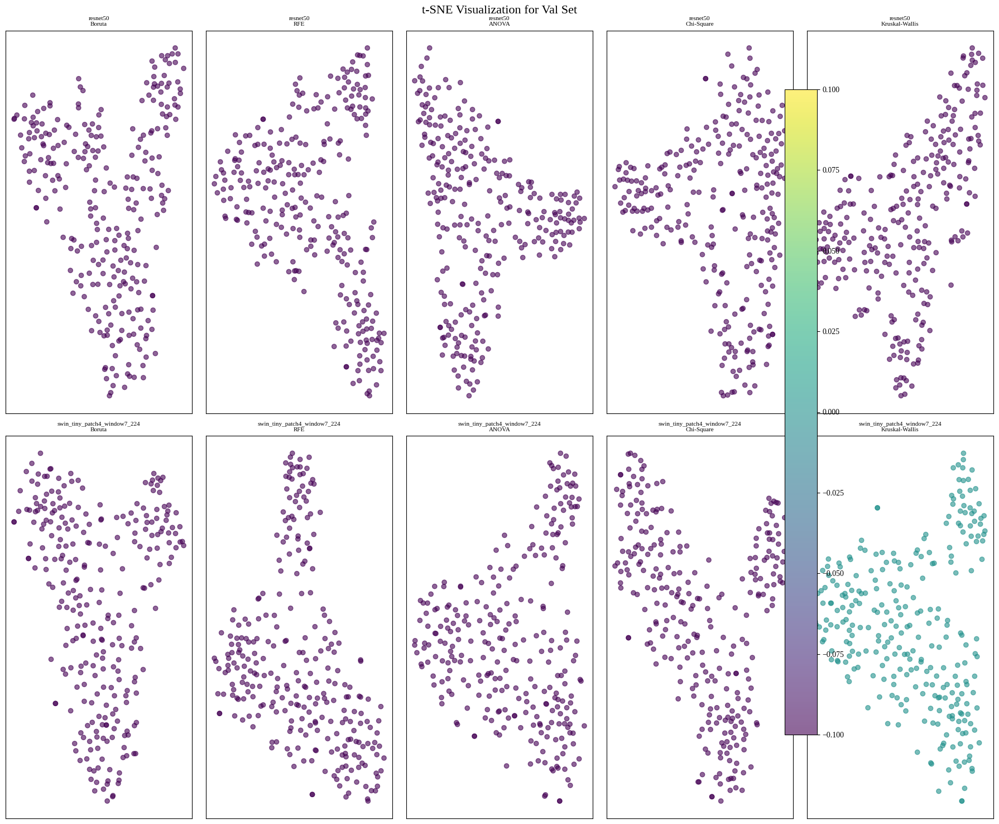

/tmp/ipykernel_239606/3076532915.py:192: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


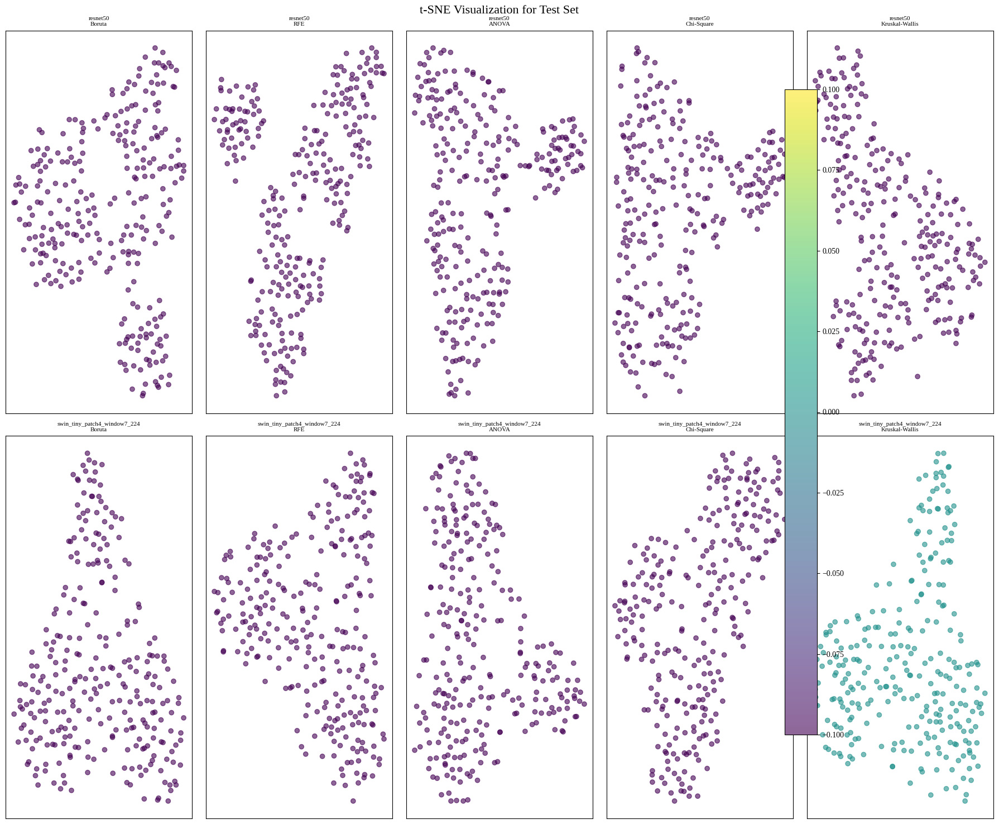

In [10]:
if __name__ == "__main__":
    features, labels = load_features_and_labels()
    selected_features = apply_feature_selection(features, labels)
    save_selected_features(selected_features)  
    plot_tsne(selected_features, labels)       


In [1]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from sklearn.manifold import TSNE

def plot_tsne(selected_features, labels):
    for split in SPLITS:
        fig, axes = plt.subplots(nrows=len(MODELS), ncols=len(METHODS), figsize=(24, 10))

        scatter = None  # To store the last valid scatter for colorbar
        y_labels = None

        for row_idx, model in enumerate(MODELS):
            for col_idx, method in enumerate(METHODS):
                ax = axes[row_idx, col_idx]
                try:
                    layer = list(MODELS[model])[-1]  # Final layer
                    X_selected = selected_features[model][layer][method][split]

                    if X_selected.ndim > 2:
                        X_selected = X_selected.reshape(X_selected.shape[0], -1)

                    if split == "train":
                        y_labels = labels["train"][model]
                    else:
                        y_labels = np.zeros(X_selected.shape[0])

                    tsne = TSNE(n_components=2, random_state=42, perplexity=30)
                    X_embedded = tsne.fit_transform(X_selected)

                    scatter = ax.scatter(X_embedded[:, 0], X_embedded[:, 1],
                                         c=y_labels, cmap='jet', alpha=0.6)
                    ax.set_xticks([])
                    ax.set_yticks([])
                    ax.set_title(f"{model}\n{method}", fontproperties=liberation_font, fontsize=10)

                except Exception as e:
                    ax.set_title(f"Error: {model} - {method}", fontsize=16)
                    ax.text(0.5, 0.5, str(e), ha='center', va='center', fontsize=16)
                    ax.set_xticks([])
                    ax.set_yticks([])

        # Adjust layout and colorbar
        fig.suptitle(f"t-SNE Visualization for {split.capitalize()} Set",
                     fontproperties=liberation_font, fontsize=16)

        fig.subplots_adjust(right=0.88)  # Leave space for colorbar
        if scatter and y_labels is not None:
            norm = mpl.colors.Normalize(vmin=np.min(y_labels), vmax=np.max(y_labels))
            cbar_ax = fig.add_axes([0.90, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
            fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap='jet'), cax=cbar_ax)

        plt.tight_layout(rect=[0, 0, 0.88, 0.95])  # Leave room for suptitle and colorbar
        plt.show()
plot_tsne(selected_features, labels)  

NameError: name 'selected_features' is not defined

🔹 ResNet50 | layer1 | Boruta | SVM


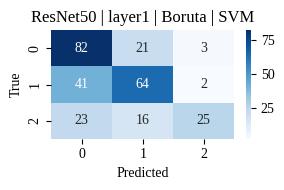

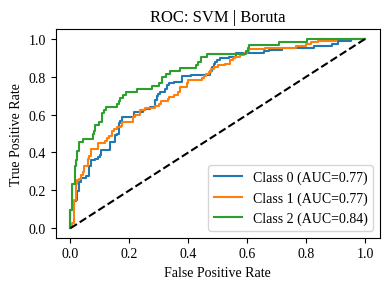

🔹 ResNet50 | layer1 | Boruta | RandomForest


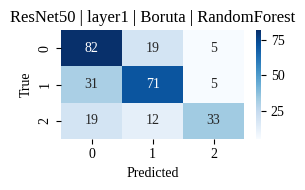

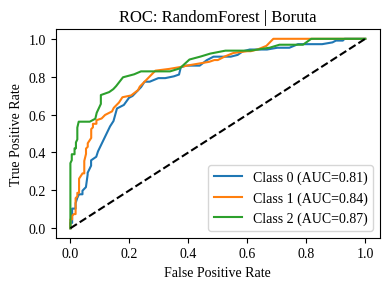

🔹 ResNet50 | layer1 | Boruta | LogisticRegression


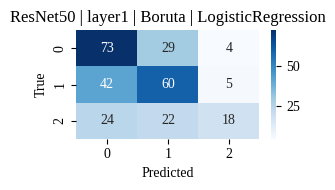

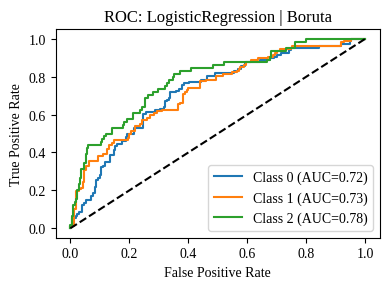

🔹 ResNet50 | layer1 | Boruta | KNN


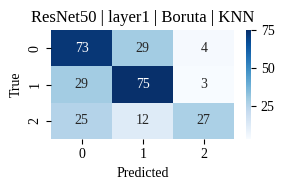

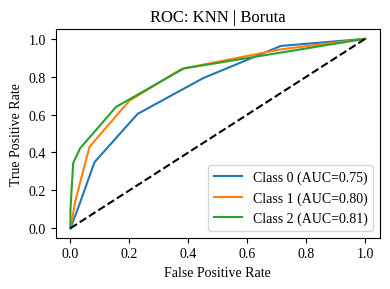

🔹 ResNet50 | layer1 | Boruta | MLP


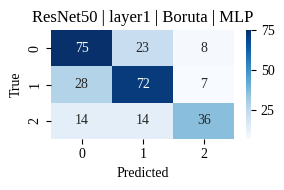

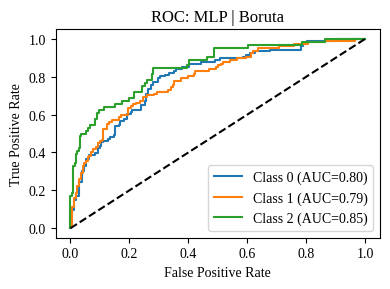

🔹 ResNet50 | layer1 | RFE | SVM


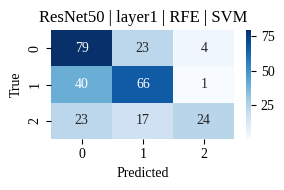

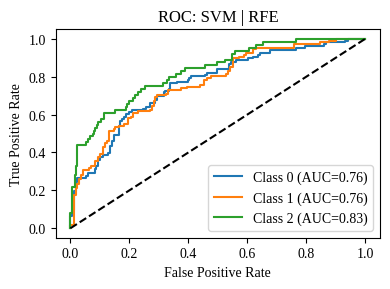

🔹 ResNet50 | layer1 | RFE | RandomForest


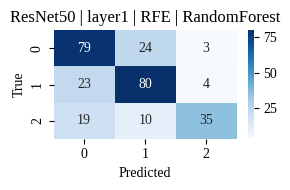

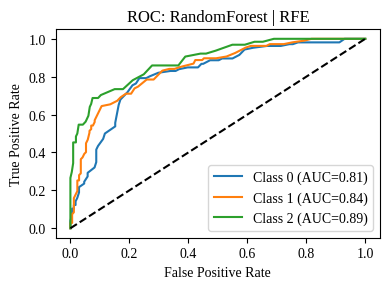

🔹 ResNet50 | layer1 | RFE | LogisticRegression


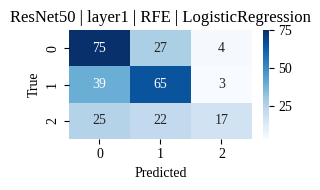

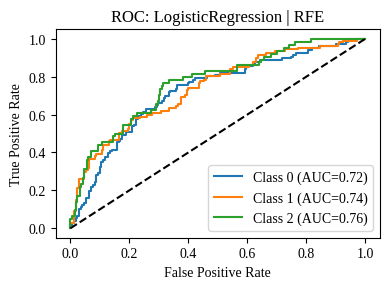

🔹 ResNet50 | layer1 | RFE | KNN


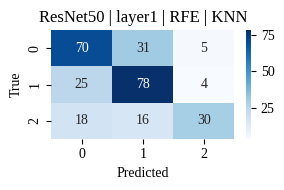

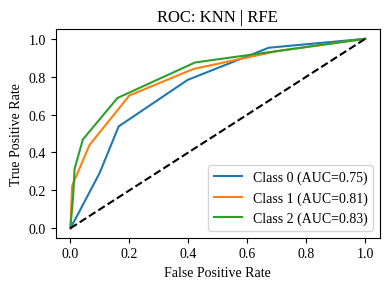

🔹 ResNet50 | layer1 | RFE | MLP


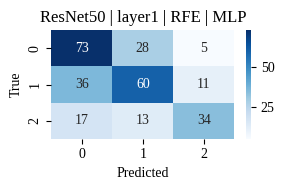

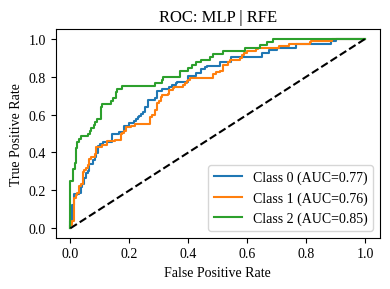

🔹 ResNet50 | layer1 | ANOVA | SVM


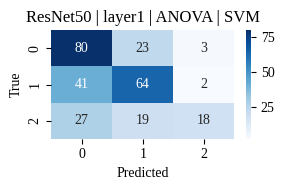

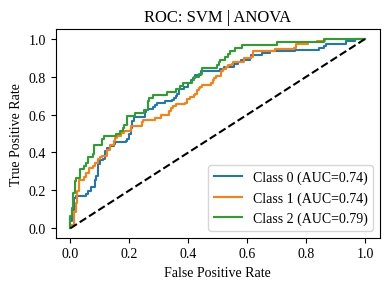

🔹 ResNet50 | layer1 | ANOVA | RandomForest


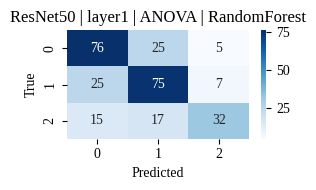

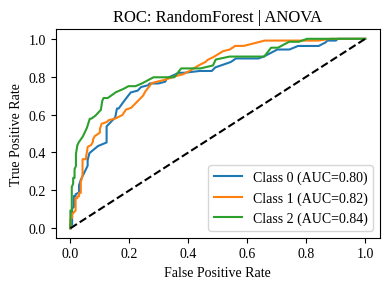

🔹 ResNet50 | layer1 | ANOVA | LogisticRegression


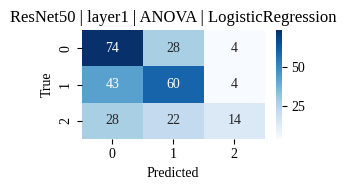

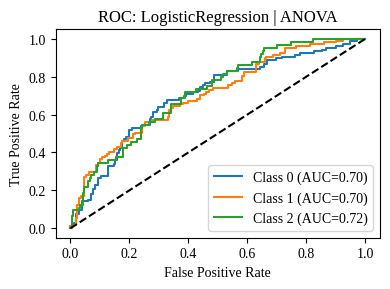

🔹 ResNet50 | layer1 | ANOVA | KNN


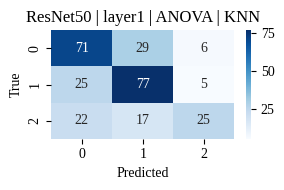

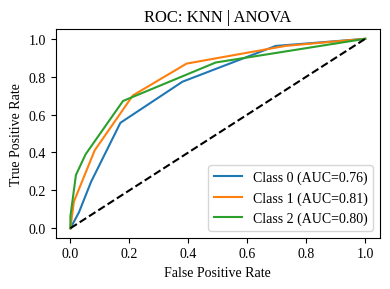

🔹 ResNet50 | layer1 | ANOVA | MLP


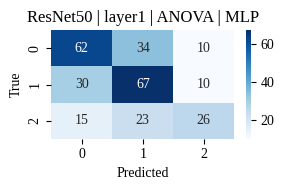

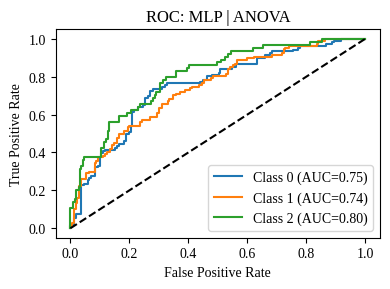

🔹 ResNet50 | layer1 | Chi-Square | SVM


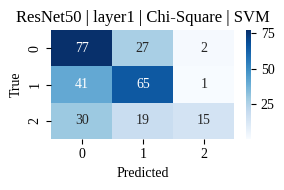

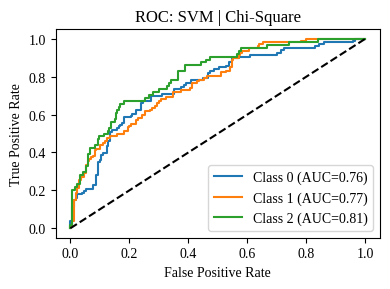

🔹 ResNet50 | layer1 | Chi-Square | RandomForest


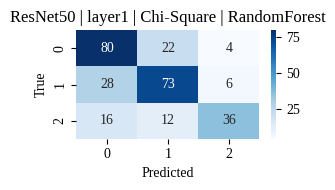

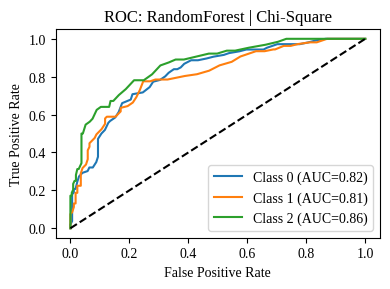

🔹 ResNet50 | layer1 | Chi-Square | LogisticRegression


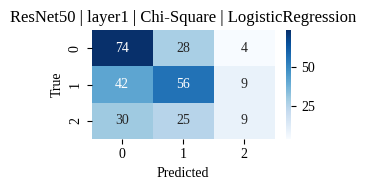

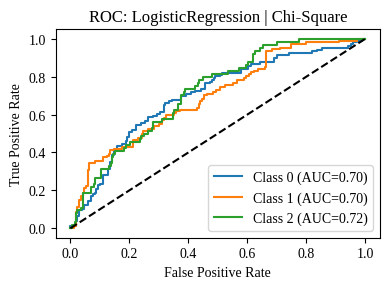

🔹 ResNet50 | layer1 | Chi-Square | KNN


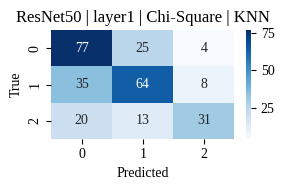

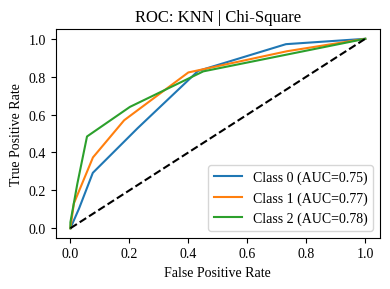

🔹 ResNet50 | layer1 | Chi-Square | MLP


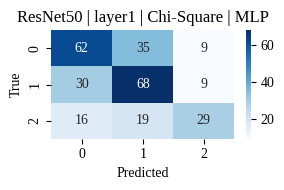

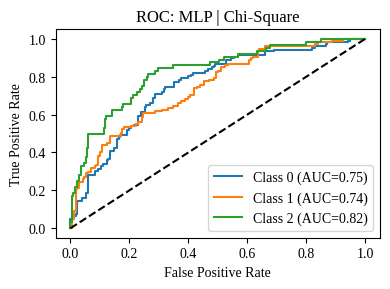

🔹 ResNet50 | layer1 | Kruskal-Wallis | SVM


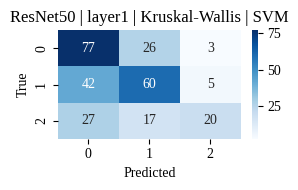

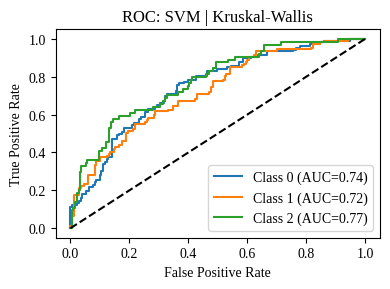

🔹 ResNet50 | layer1 | Kruskal-Wallis | RandomForest


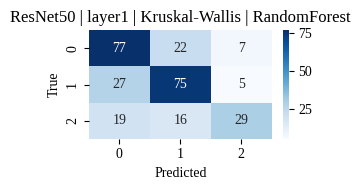

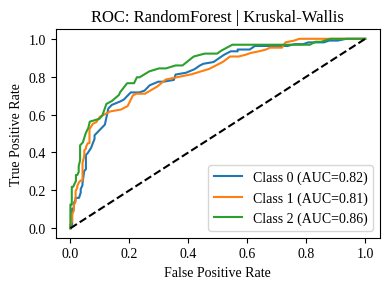

🔹 ResNet50 | layer1 | Kruskal-Wallis | LogisticRegression


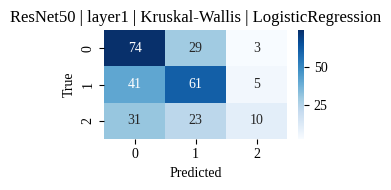

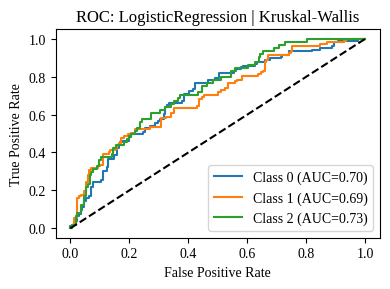

🔹 ResNet50 | layer1 | Kruskal-Wallis | KNN


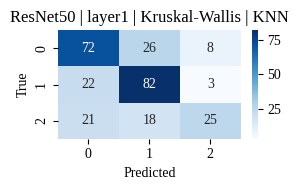

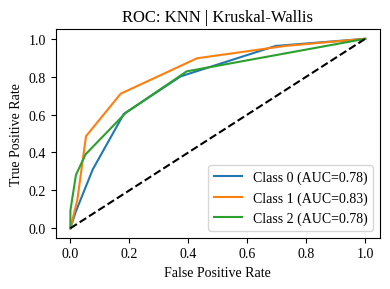

🔹 ResNet50 | layer1 | Kruskal-Wallis | MLP


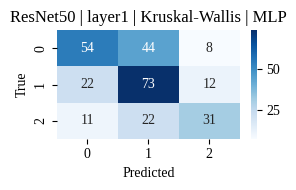

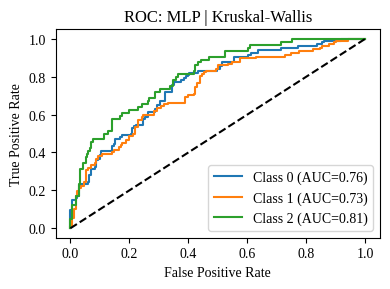

🔹 ResNet50 | layer2 | Boruta | SVM


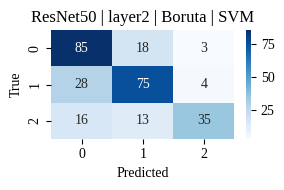

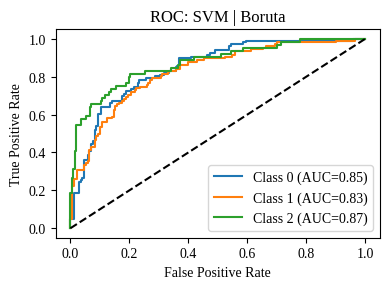

🔹 ResNet50 | layer2 | Boruta | RandomForest


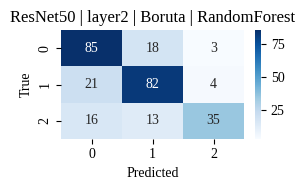

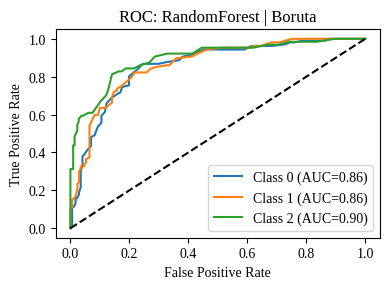

🔹 ResNet50 | layer2 | Boruta | LogisticRegression


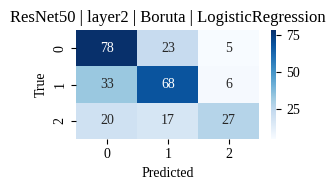

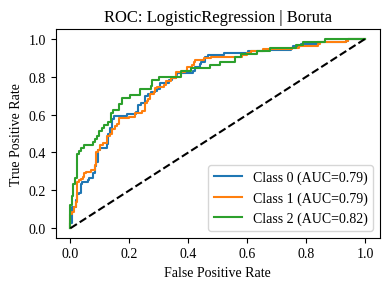

🔹 ResNet50 | layer2 | Boruta | KNN


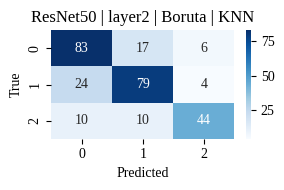

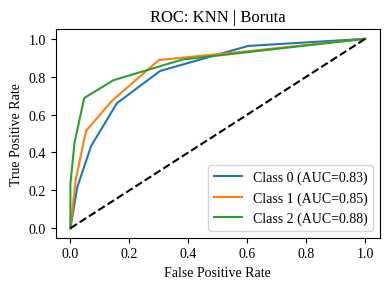

🔹 ResNet50 | layer2 | Boruta | MLP


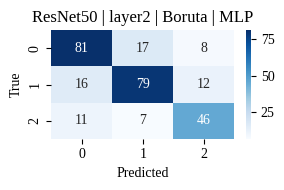

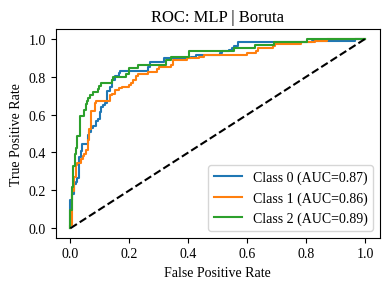

🔹 ResNet50 | layer2 | RFE | SVM


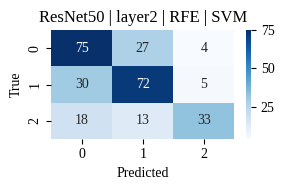

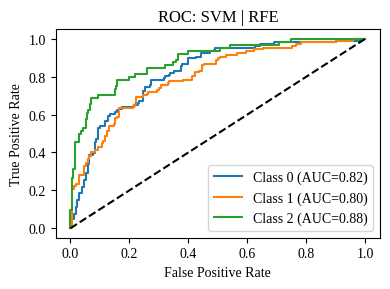

🔹 ResNet50 | layer2 | RFE | RandomForest


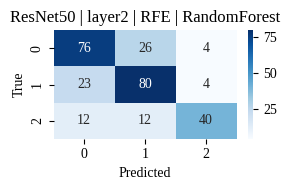

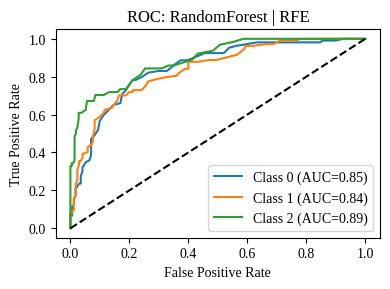

🔹 ResNet50 | layer2 | RFE | LogisticRegression


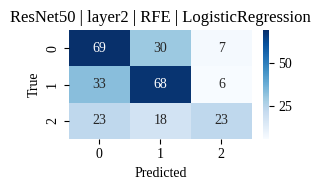

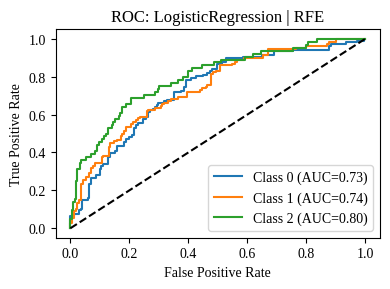

🔹 ResNet50 | layer2 | RFE | KNN


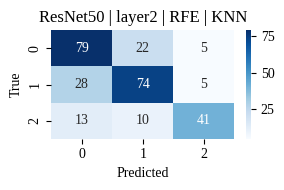

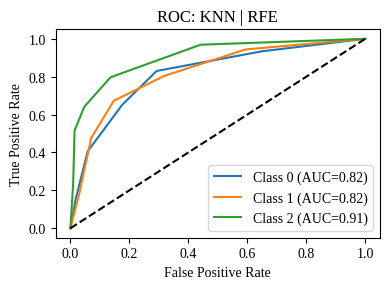

🔹 ResNet50 | layer2 | RFE | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


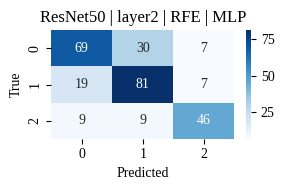

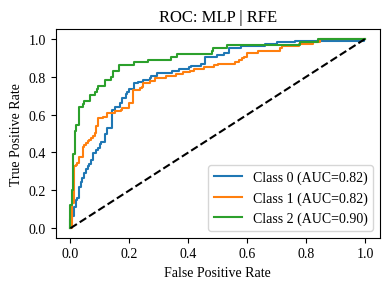

🔹 ResNet50 | layer2 | ANOVA | SVM


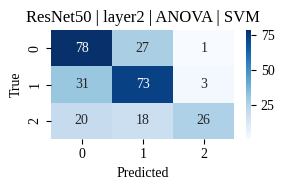

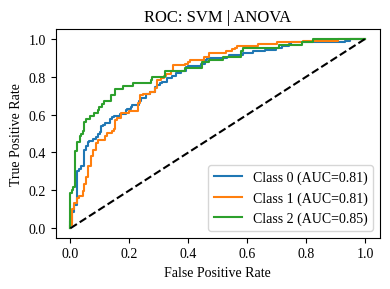

🔹 ResNet50 | layer2 | ANOVA | RandomForest


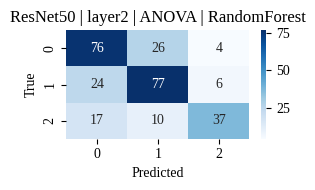

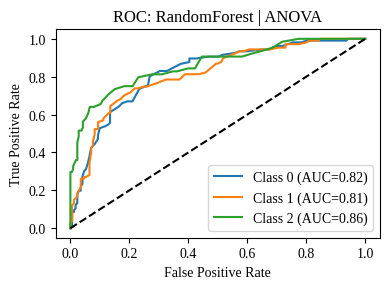

🔹 ResNet50 | layer2 | ANOVA | LogisticRegression


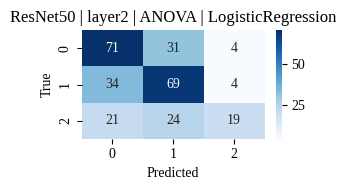

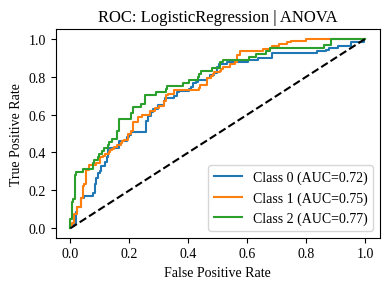

🔹 ResNet50 | layer2 | ANOVA | KNN


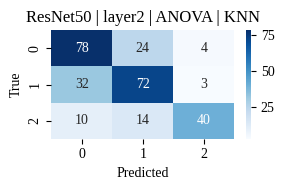

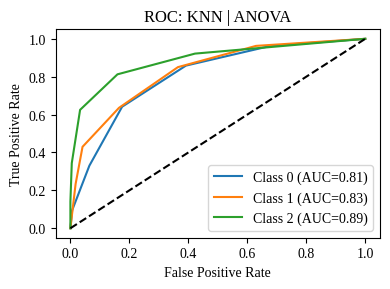

🔹 ResNet50 | layer2 | ANOVA | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


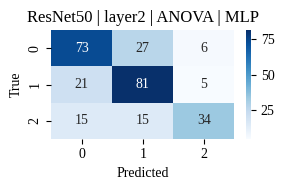

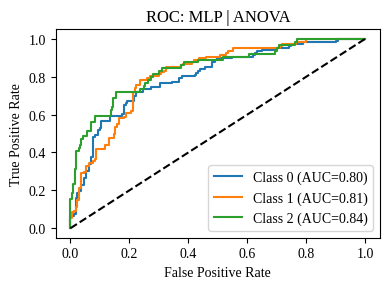

🔹 ResNet50 | layer2 | Chi-Square | SVM


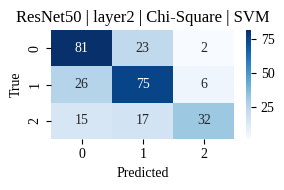

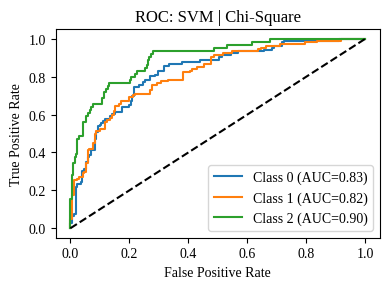

🔹 ResNet50 | layer2 | Chi-Square | RandomForest


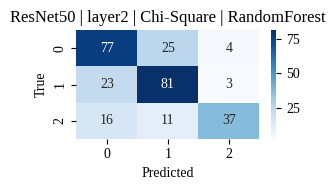

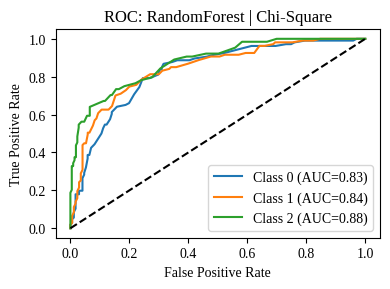

🔹 ResNet50 | layer2 | Chi-Square | LogisticRegression


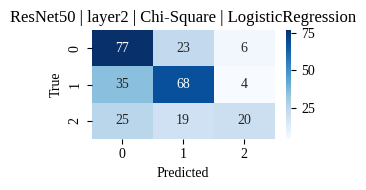

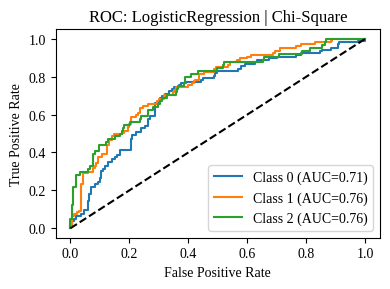

🔹 ResNet50 | layer2 | Chi-Square | KNN


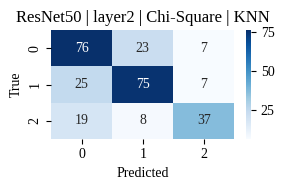

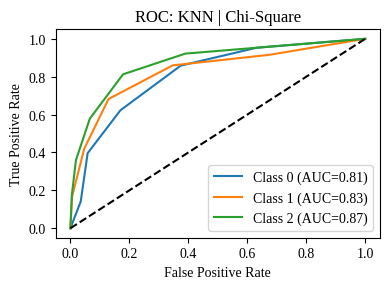

🔹 ResNet50 | layer2 | Chi-Square | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


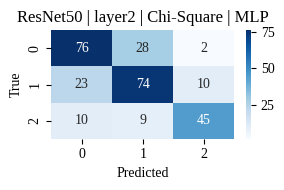

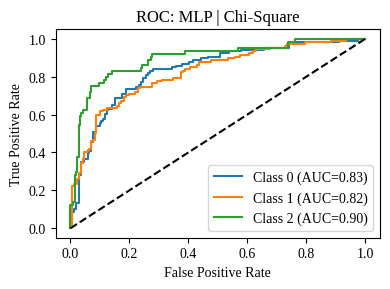

🔹 ResNet50 | layer2 | Kruskal-Wallis | SVM


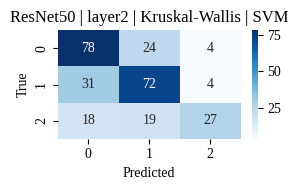

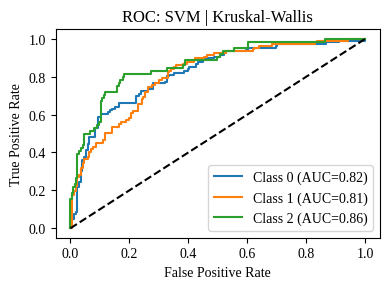

🔹 ResNet50 | layer2 | Kruskal-Wallis | RandomForest


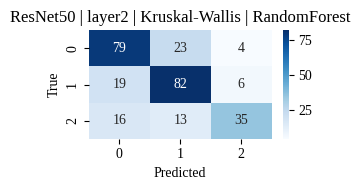

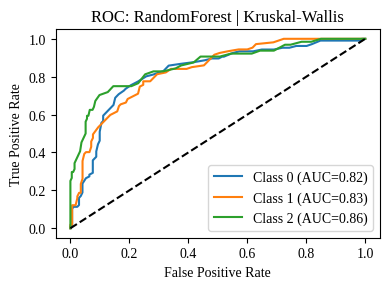

🔹 ResNet50 | layer2 | Kruskal-Wallis | LogisticRegression


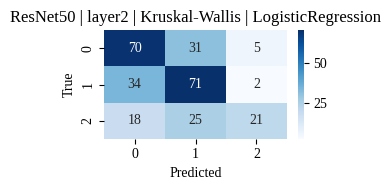

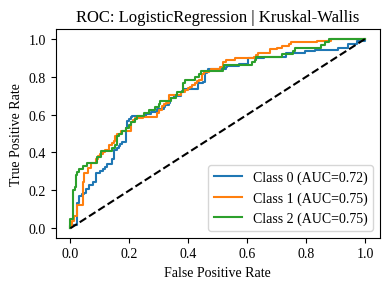

🔹 ResNet50 | layer2 | Kruskal-Wallis | KNN


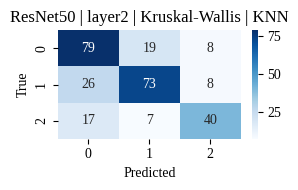

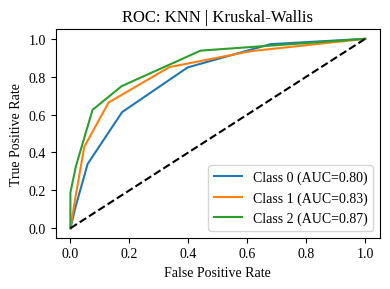

🔹 ResNet50 | layer2 | Kruskal-Wallis | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


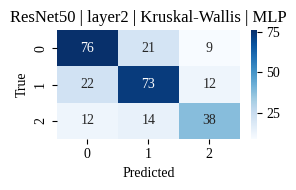

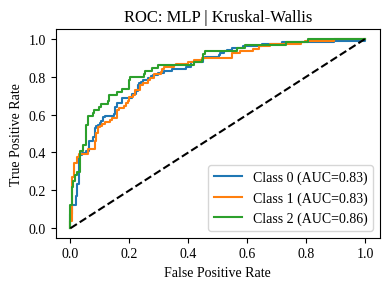

🔹 ResNet50 | layer3 | Boruta | SVM


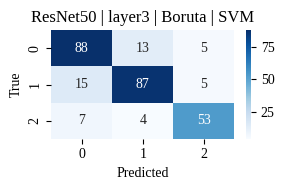

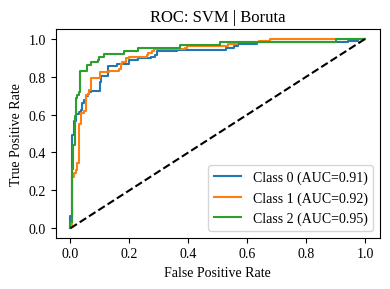

🔹 ResNet50 | layer3 | Boruta | RandomForest


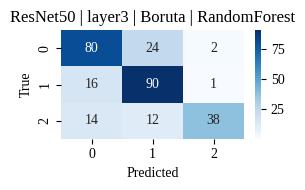

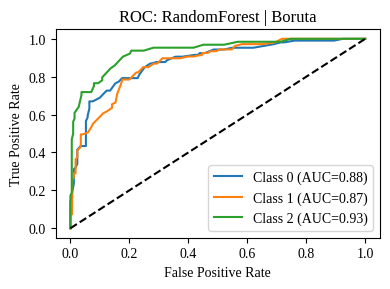

🔹 ResNet50 | layer3 | Boruta | LogisticRegression


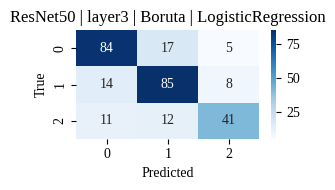

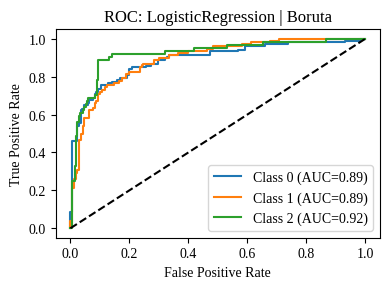

🔹 ResNet50 | layer3 | Boruta | KNN


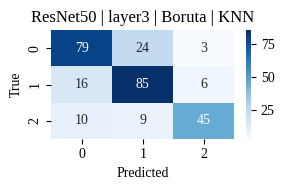

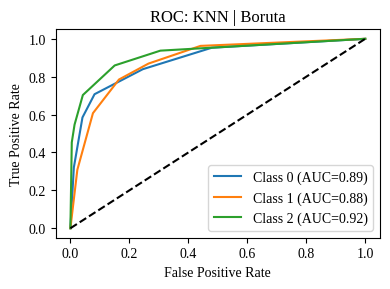

🔹 ResNet50 | layer3 | Boruta | MLP


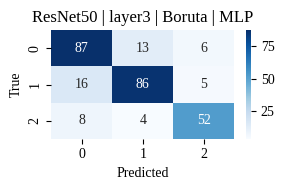

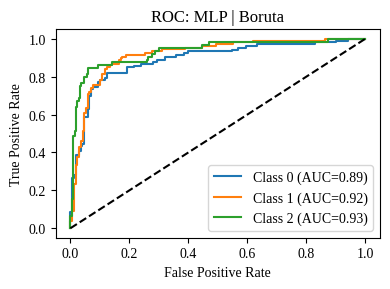

🔹 ResNet50 | layer3 | RFE | SVM


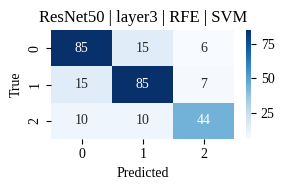

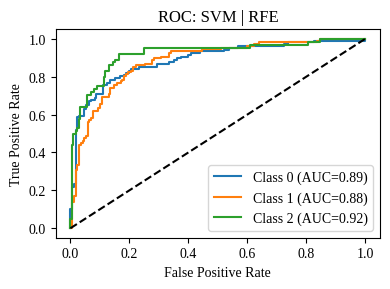

🔹 ResNet50 | layer3 | RFE | RandomForest


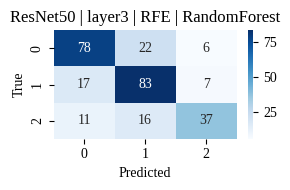

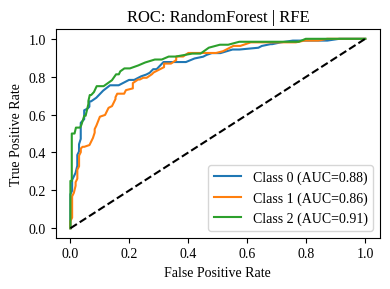

🔹 ResNet50 | layer3 | RFE | LogisticRegression


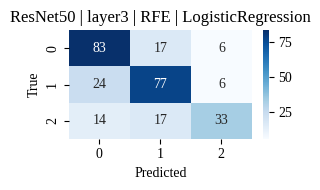

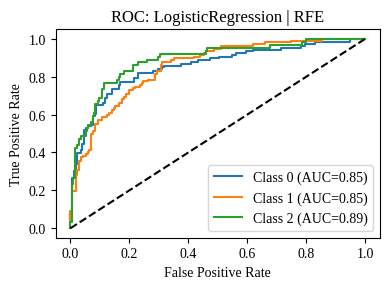

🔹 ResNet50 | layer3 | RFE | KNN


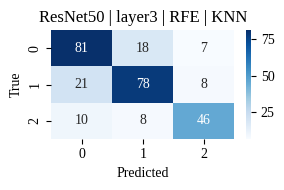

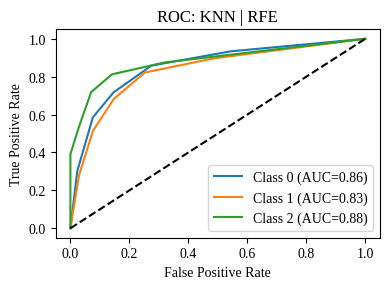

🔹 ResNet50 | layer3 | RFE | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


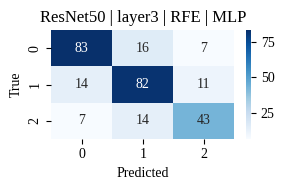

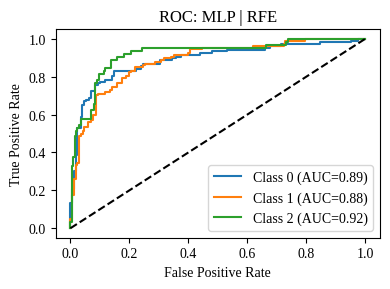

🔹 ResNet50 | layer3 | ANOVA | SVM


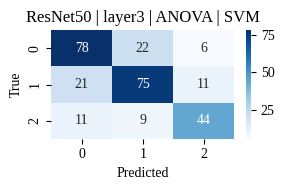

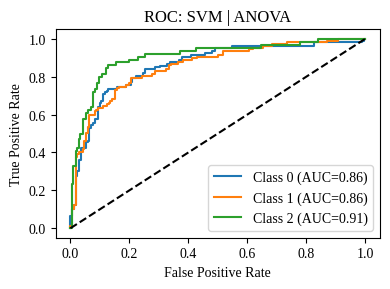

🔹 ResNet50 | layer3 | ANOVA | RandomForest


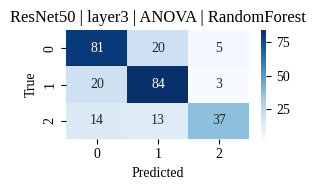

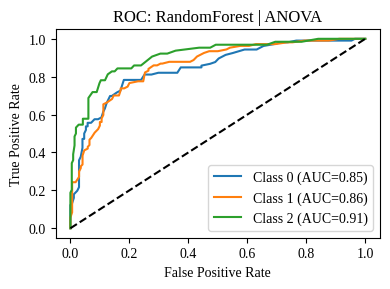

🔹 ResNet50 | layer3 | ANOVA | LogisticRegression


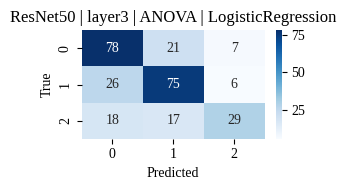

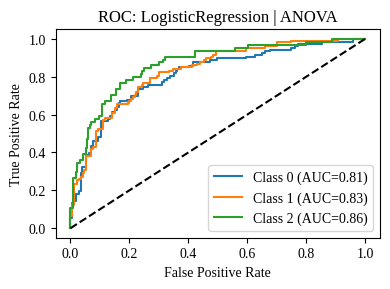

🔹 ResNet50 | layer3 | ANOVA | KNN


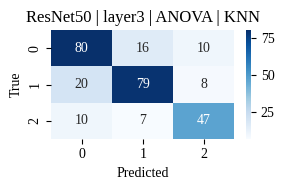

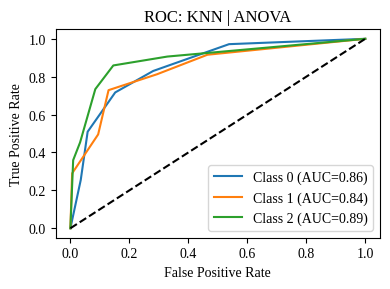

🔹 ResNet50 | layer3 | ANOVA | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


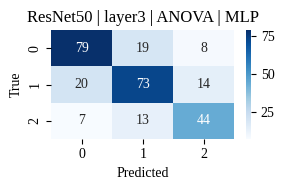

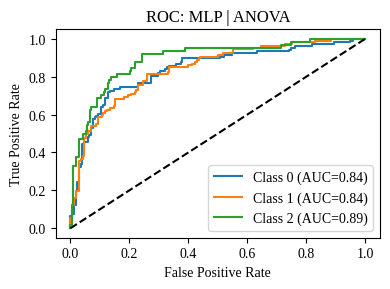

🔹 ResNet50 | layer3 | Chi-Square | SVM


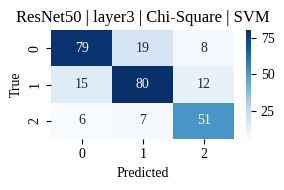

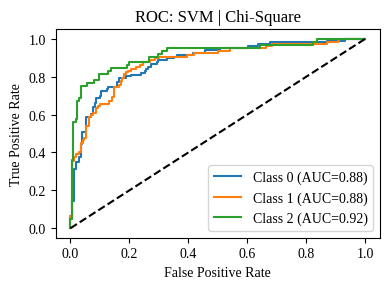

🔹 ResNet50 | layer3 | Chi-Square | RandomForest


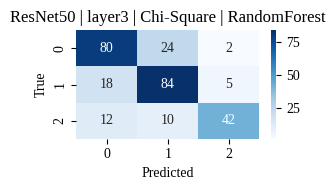

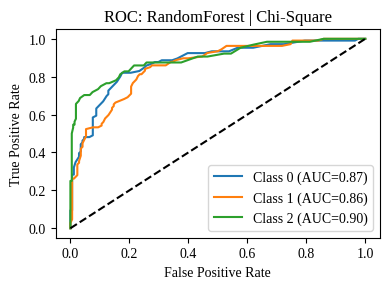

🔹 ResNet50 | layer3 | Chi-Square | LogisticRegression


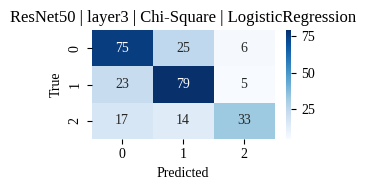

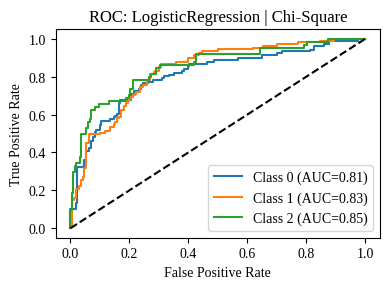

🔹 ResNet50 | layer3 | Chi-Square | KNN


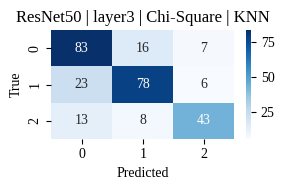

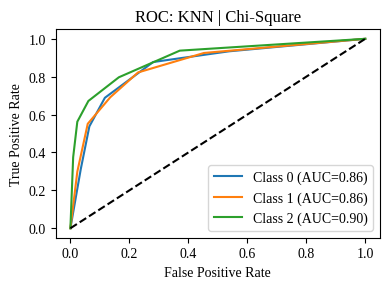

🔹 ResNet50 | layer3 | Chi-Square | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


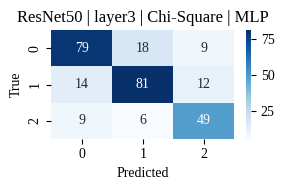

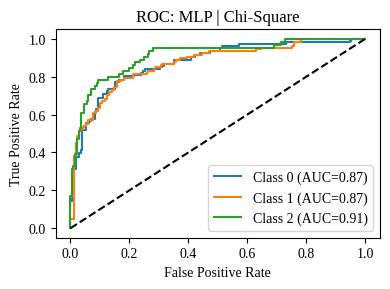

🔹 ResNet50 | layer3 | Kruskal-Wallis | SVM


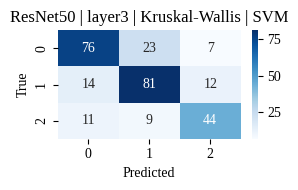

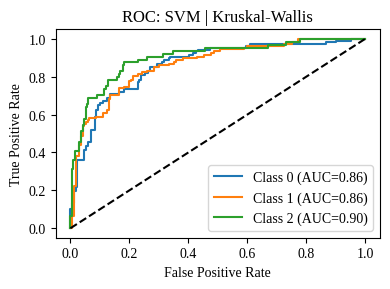

🔹 ResNet50 | layer3 | Kruskal-Wallis | RandomForest


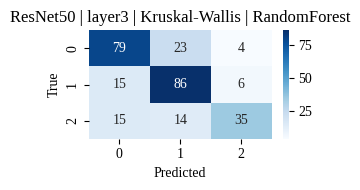

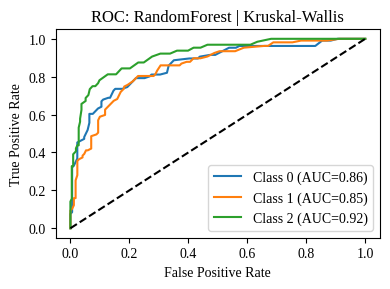

🔹 ResNet50 | layer3 | Kruskal-Wallis | LogisticRegression


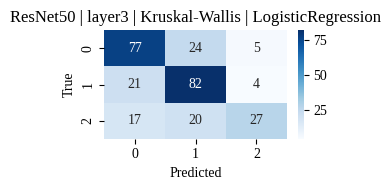

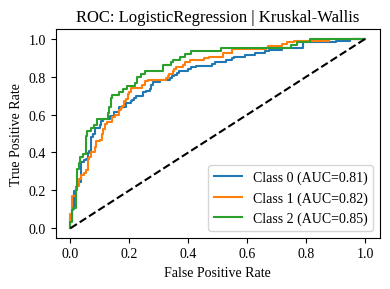

🔹 ResNet50 | layer3 | Kruskal-Wallis | KNN


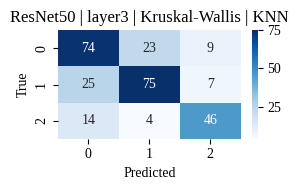

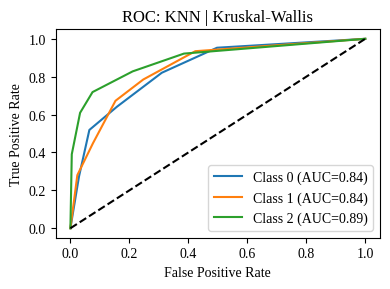

🔹 ResNet50 | layer3 | Kruskal-Wallis | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


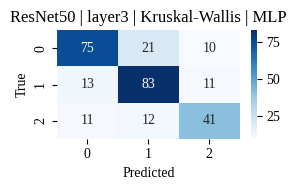

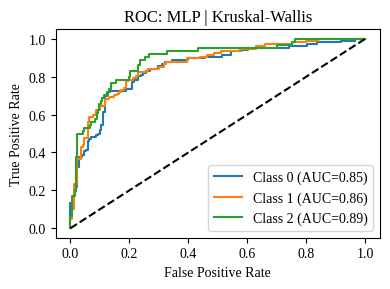

🔹 ResNet50 | layer4 | Boruta | SVM


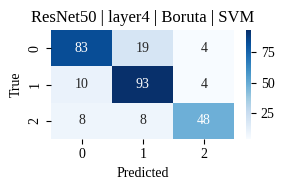

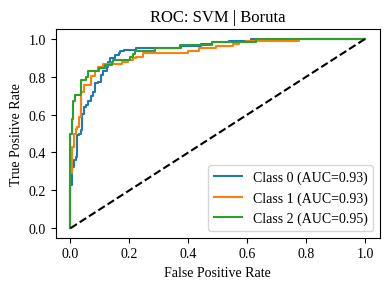

🔹 ResNet50 | layer4 | Boruta | RandomForest


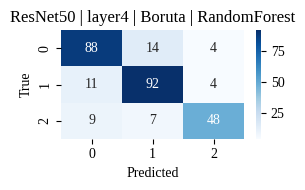

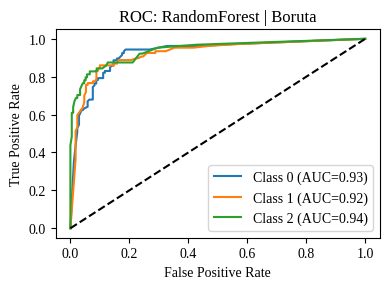

🔹 ResNet50 | layer4 | Boruta | LogisticRegression


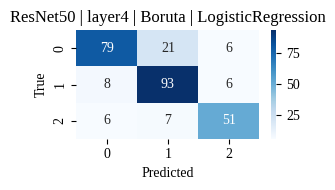

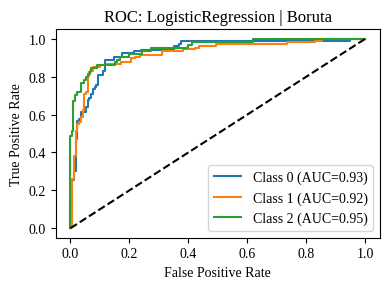

🔹 ResNet50 | layer4 | Boruta | KNN


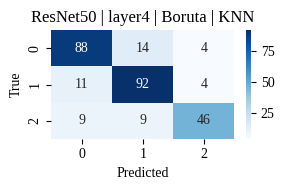

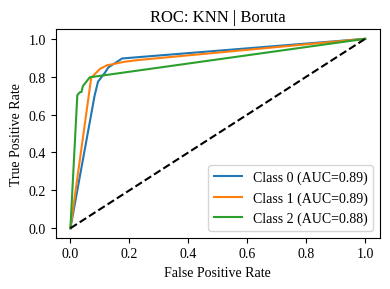

🔹 ResNet50 | layer4 | Boruta | MLP


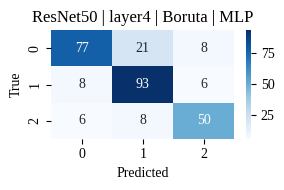

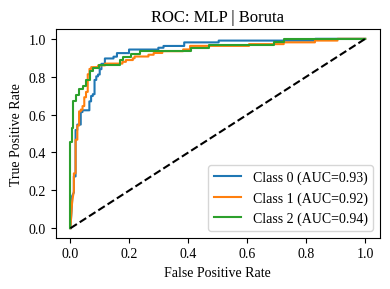

🔹 ResNet50 | layer4 | RFE | SVM


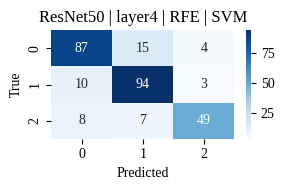

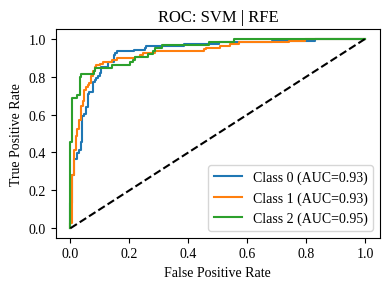

🔹 ResNet50 | layer4 | RFE | RandomForest


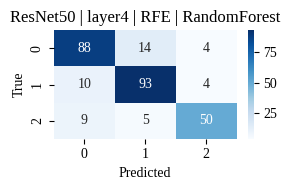

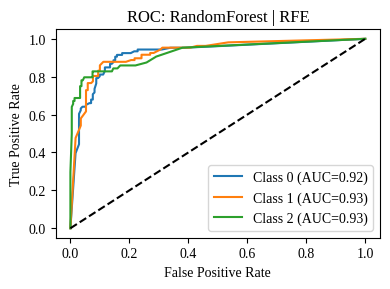

🔹 ResNet50 | layer4 | RFE | LogisticRegression


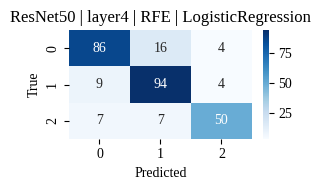

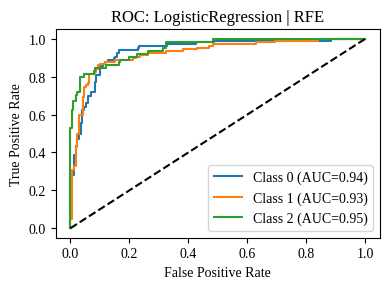

🔹 ResNet50 | layer4 | RFE | KNN


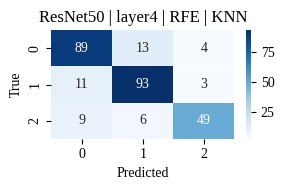

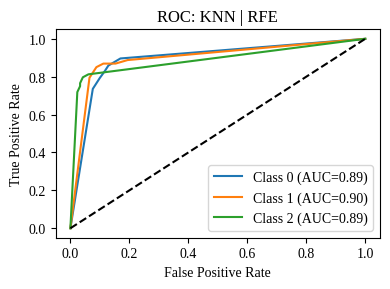

🔹 ResNet50 | layer4 | RFE | MLP


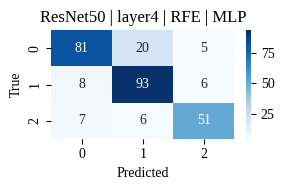

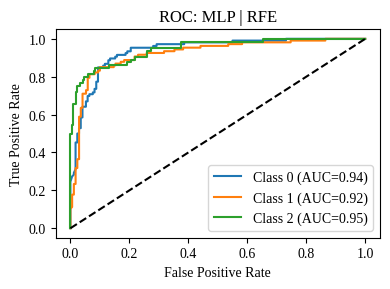

🔹 ResNet50 | layer4 | ANOVA | SVM


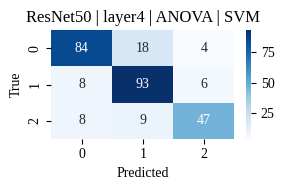

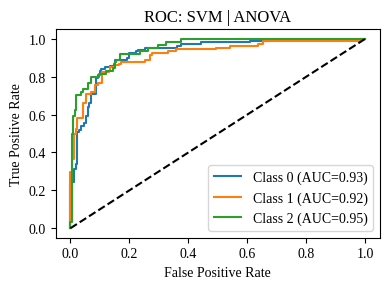

🔹 ResNet50 | layer4 | ANOVA | RandomForest


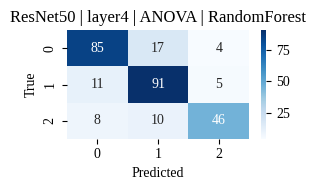

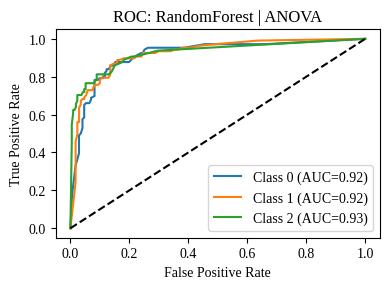

🔹 ResNet50 | layer4 | ANOVA | LogisticRegression


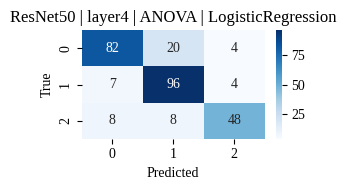

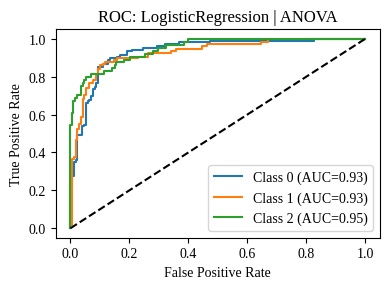

🔹 ResNet50 | layer4 | ANOVA | KNN


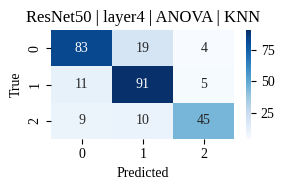

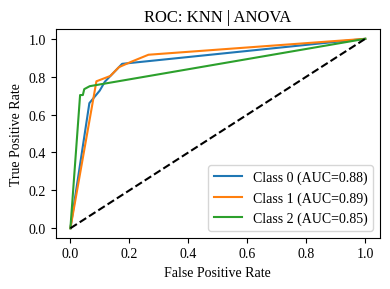

🔹 ResNet50 | layer4 | ANOVA | MLP


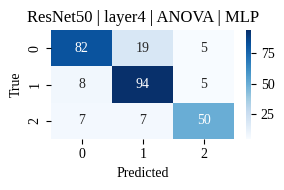

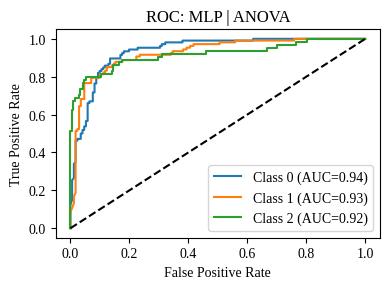

🔹 ResNet50 | layer4 | Chi-Square | SVM


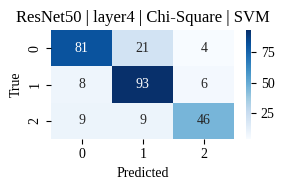

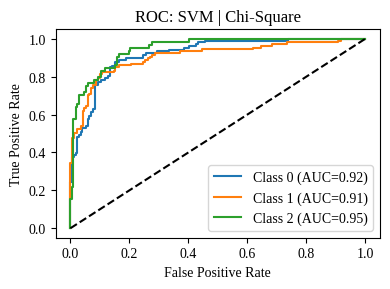

🔹 ResNet50 | layer4 | Chi-Square | RandomForest


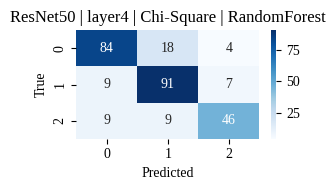

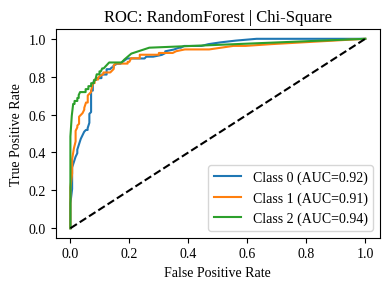

🔹 ResNet50 | layer4 | Chi-Square | LogisticRegression


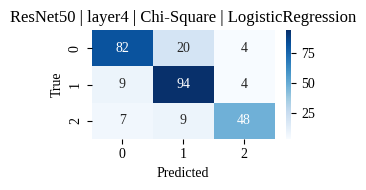

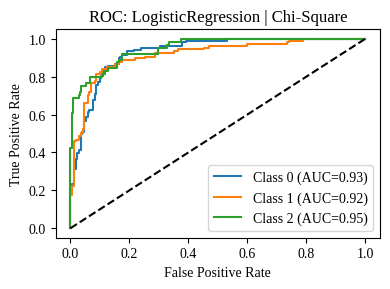

🔹 ResNet50 | layer4 | Chi-Square | KNN


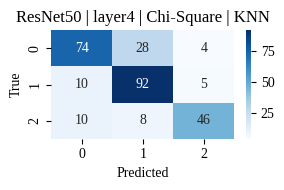

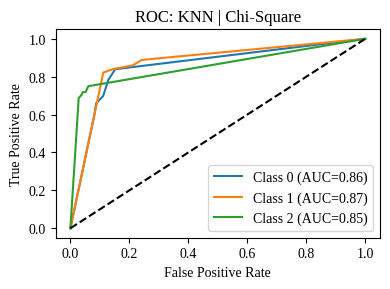

🔹 ResNet50 | layer4 | Chi-Square | MLP


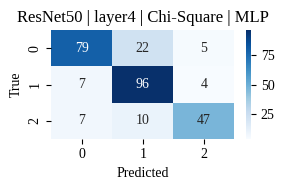

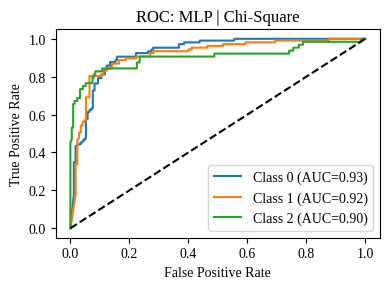

🔹 ResNet50 | layer4 | Kruskal-Wallis | SVM


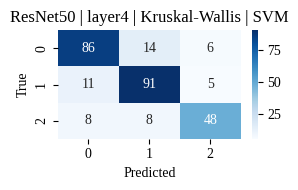

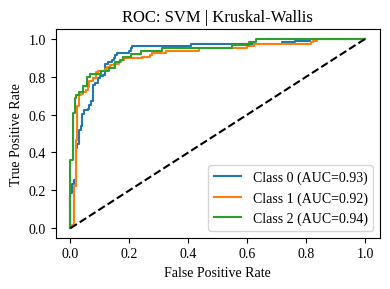

🔹 ResNet50 | layer4 | Kruskal-Wallis | RandomForest


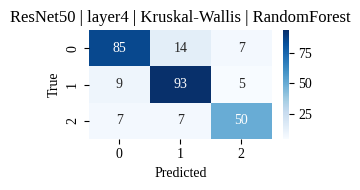

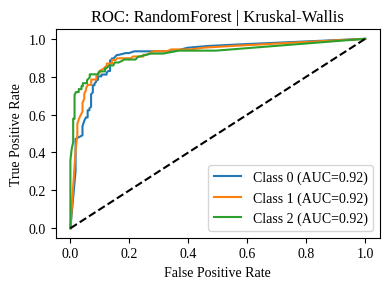

🔹 ResNet50 | layer4 | Kruskal-Wallis | LogisticRegression


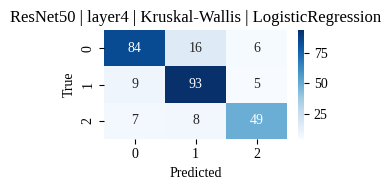

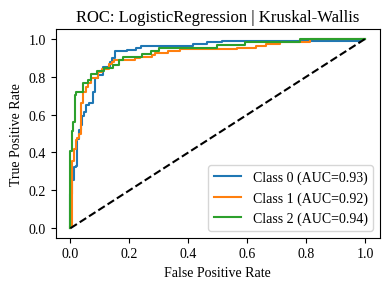

🔹 ResNet50 | layer4 | Kruskal-Wallis | KNN


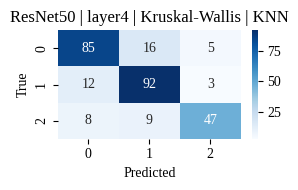

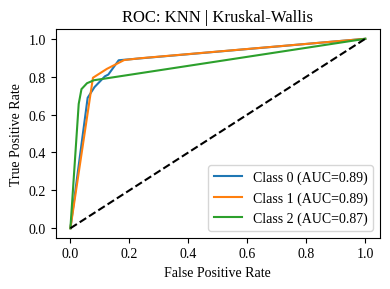

🔹 ResNet50 | layer4 | Kruskal-Wallis | MLP


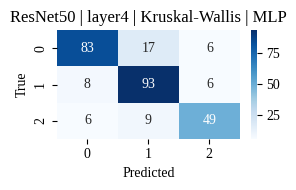

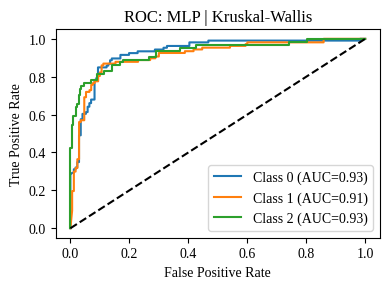

🔹 Swin-Tiny | layers_0_blocks_0 | Boruta | SVM


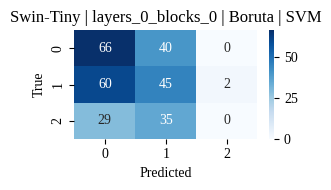

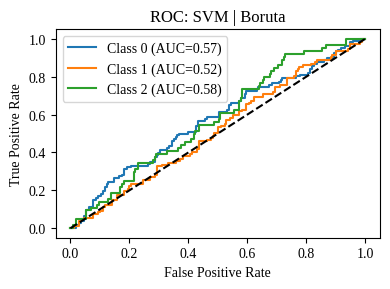

🔹 Swin-Tiny | layers_0_blocks_0 | Boruta | RandomForest


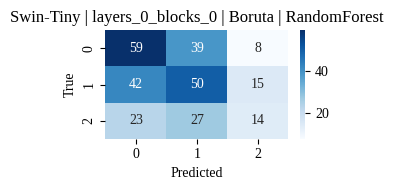

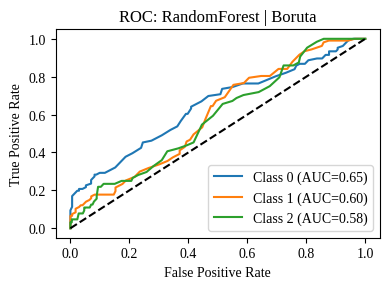

🔹 Swin-Tiny | layers_0_blocks_0 | Boruta | LogisticRegression


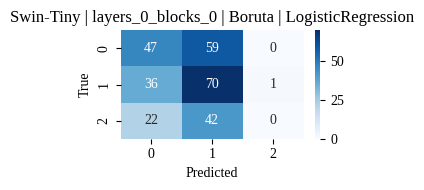

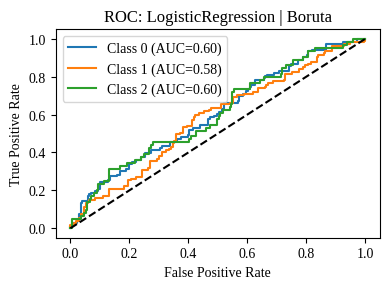

🔹 Swin-Tiny | layers_0_blocks_0 | Boruta | KNN


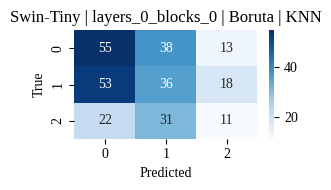

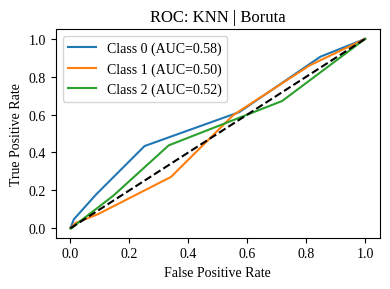

🔹 Swin-Tiny | layers_0_blocks_0 | Boruta | MLP


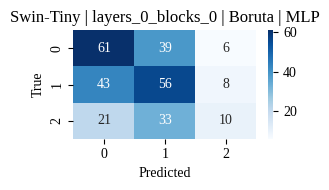

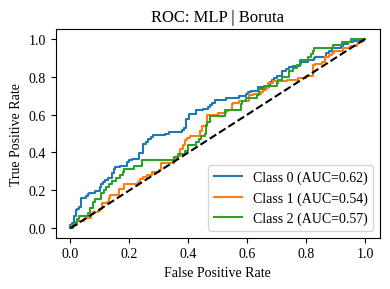

🔹 Swin-Tiny | layers_0_blocks_0 | RFE | SVM


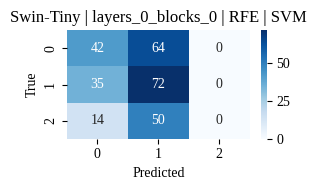

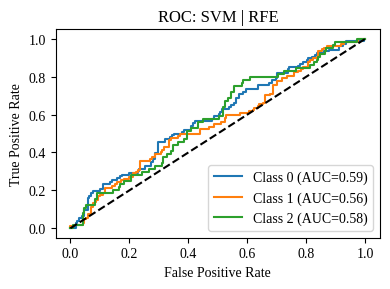

🔹 Swin-Tiny | layers_0_blocks_0 | RFE | RandomForest


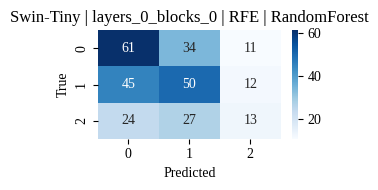

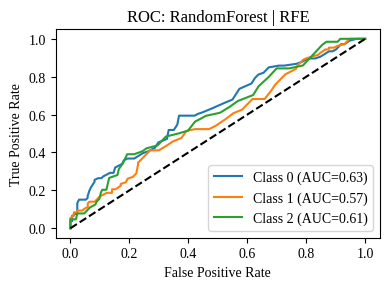

🔹 Swin-Tiny | layers_0_blocks_0 | RFE | LogisticRegression


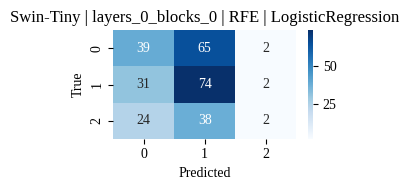

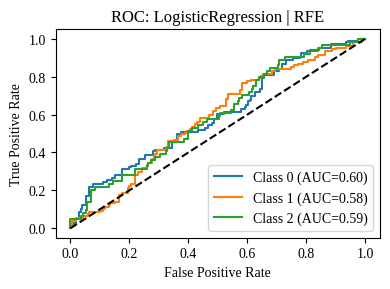

🔹 Swin-Tiny | layers_0_blocks_0 | RFE | KNN


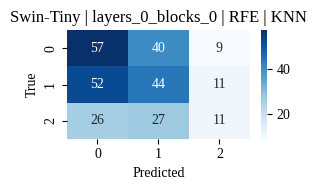

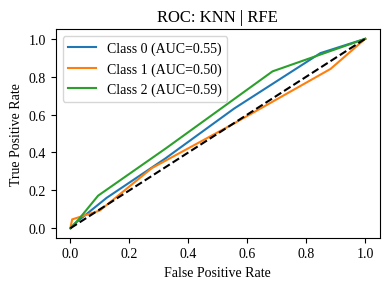

🔹 Swin-Tiny | layers_0_blocks_0 | RFE | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


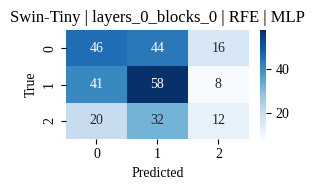

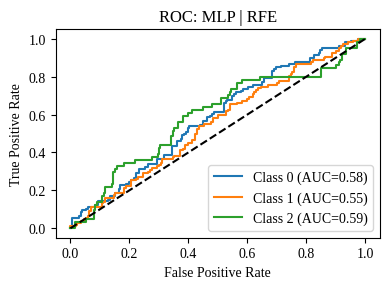

🔹 Swin-Tiny | layers_0_blocks_0 | ANOVA | SVM


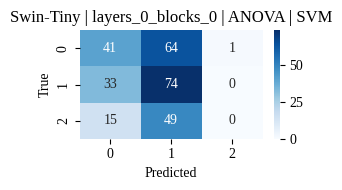

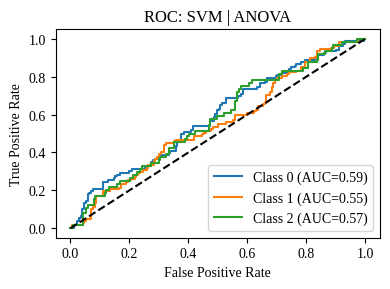

🔹 Swin-Tiny | layers_0_blocks_0 | ANOVA | RandomForest


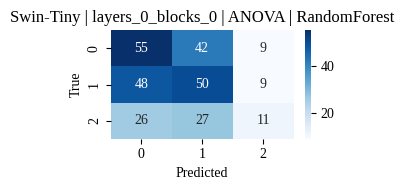

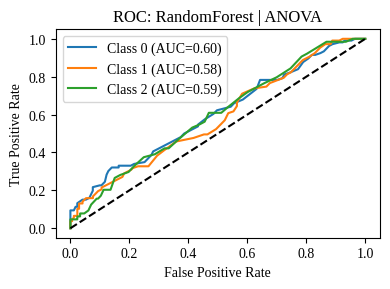

🔹 Swin-Tiny | layers_0_blocks_0 | ANOVA | LogisticRegression


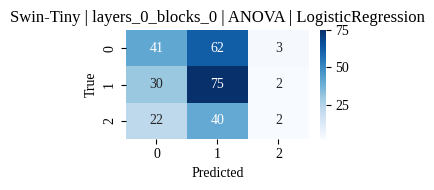

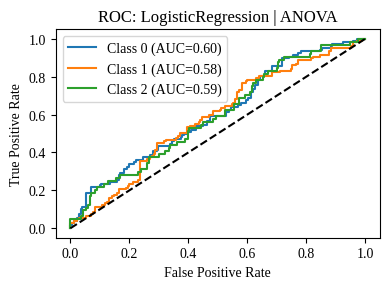

🔹 Swin-Tiny | layers_0_blocks_0 | ANOVA | KNN


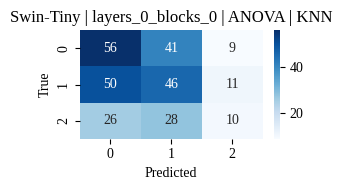

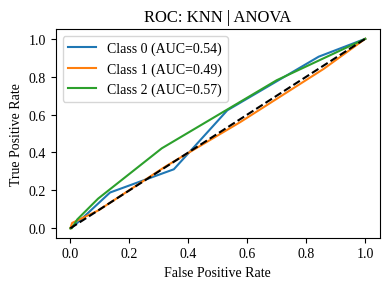

🔹 Swin-Tiny | layers_0_blocks_0 | ANOVA | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


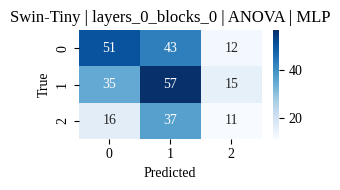

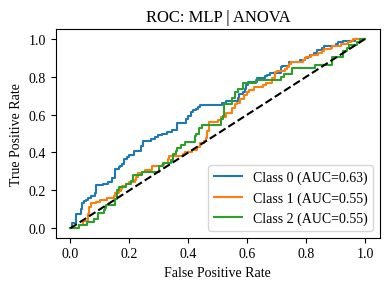

🔹 Swin-Tiny | layers_0_blocks_0 | Chi-Square | SVM


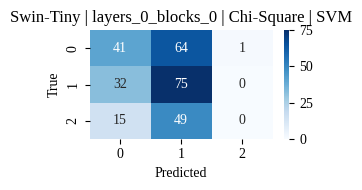

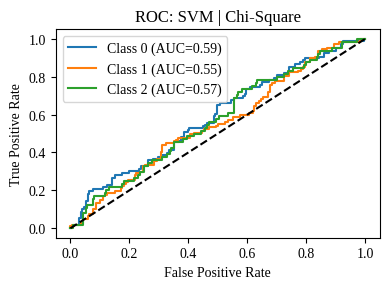

🔹 Swin-Tiny | layers_0_blocks_0 | Chi-Square | RandomForest


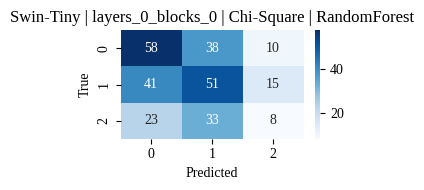

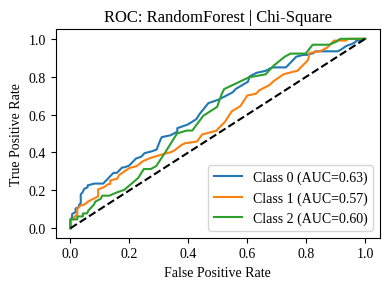

🔹 Swin-Tiny | layers_0_blocks_0 | Chi-Square | LogisticRegression


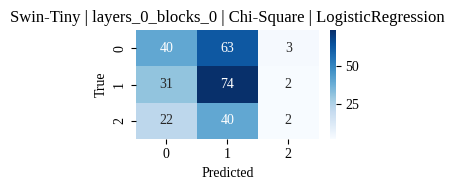

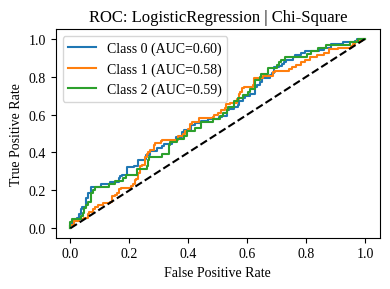

🔹 Swin-Tiny | layers_0_blocks_0 | Chi-Square | KNN


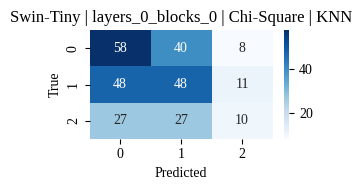

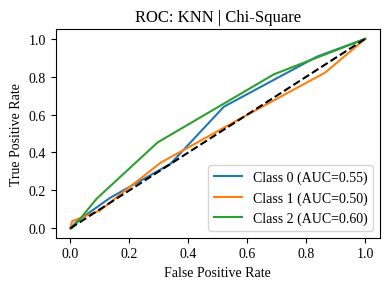

🔹 Swin-Tiny | layers_0_blocks_0 | Chi-Square | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


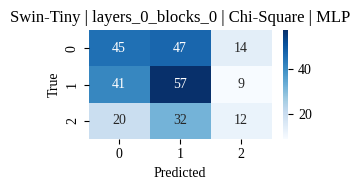

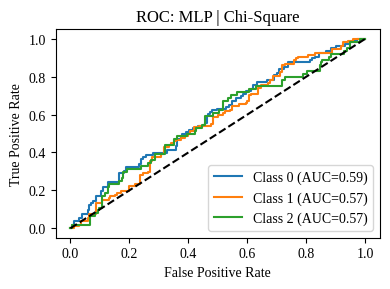

🔹 Swin-Tiny | layers_0_blocks_0 | Kruskal-Wallis | SVM


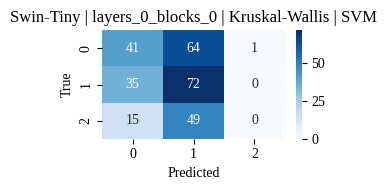

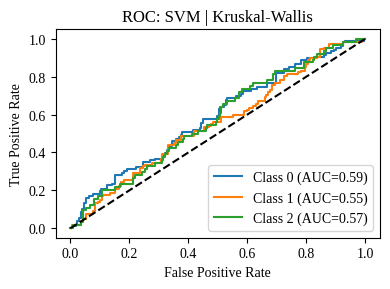

🔹 Swin-Tiny | layers_0_blocks_0 | Kruskal-Wallis | RandomForest


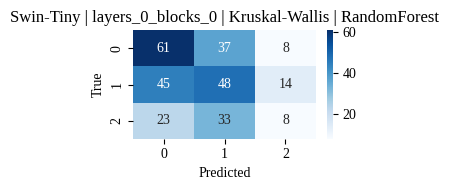

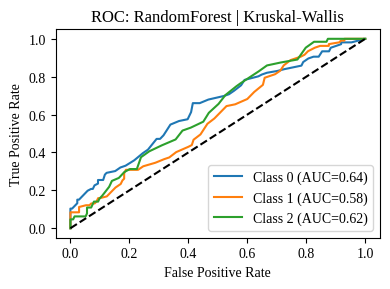

🔹 Swin-Tiny | layers_0_blocks_0 | Kruskal-Wallis | LogisticRegression


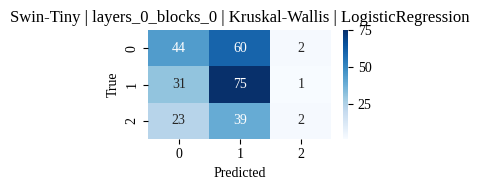

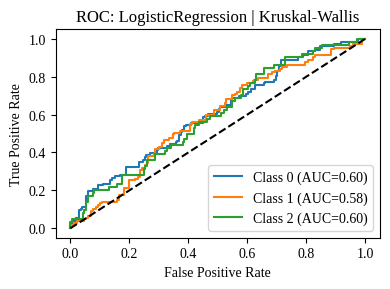

🔹 Swin-Tiny | layers_0_blocks_0 | Kruskal-Wallis | KNN


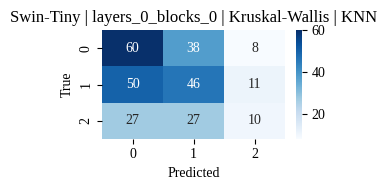

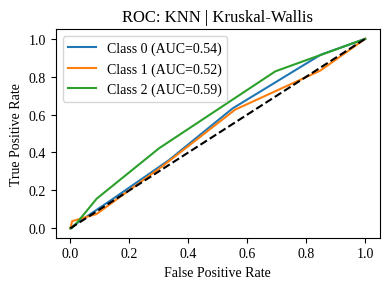

🔹 Swin-Tiny | layers_0_blocks_0 | Kruskal-Wallis | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


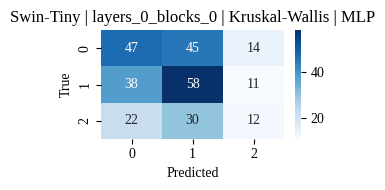

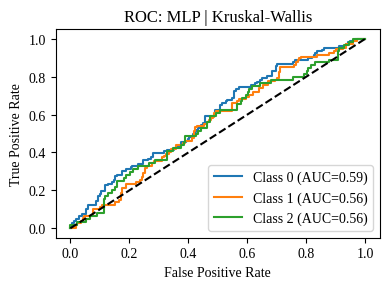

🔹 Swin-Tiny | layers_1_blocks_0 | Boruta | SVM


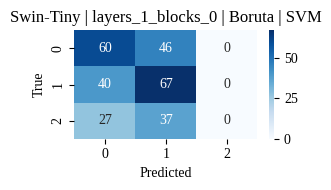

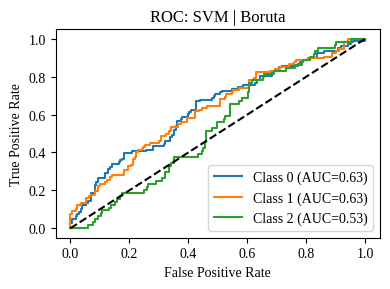

🔹 Swin-Tiny | layers_1_blocks_0 | Boruta | RandomForest


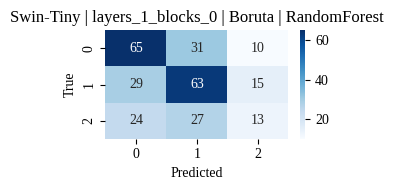

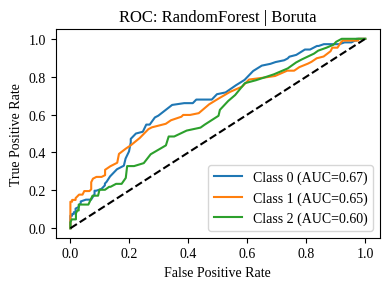

🔹 Swin-Tiny | layers_1_blocks_0 | Boruta | LogisticRegression


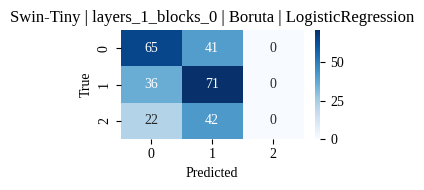

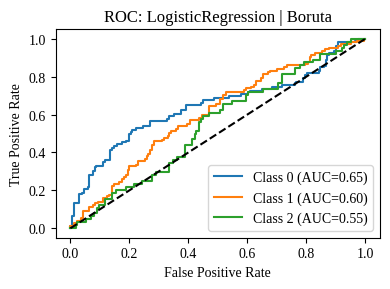

🔹 Swin-Tiny | layers_1_blocks_0 | Boruta | KNN


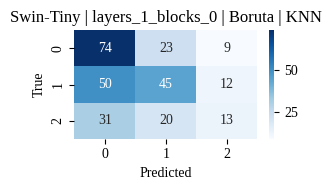

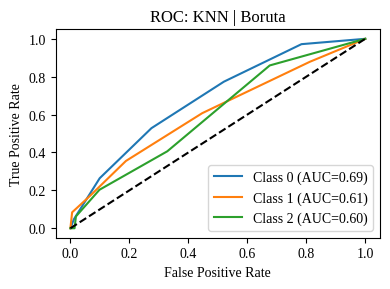

🔹 Swin-Tiny | layers_1_blocks_0 | Boruta | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


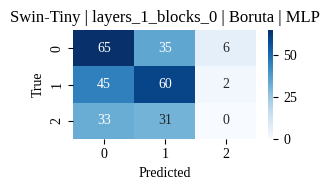

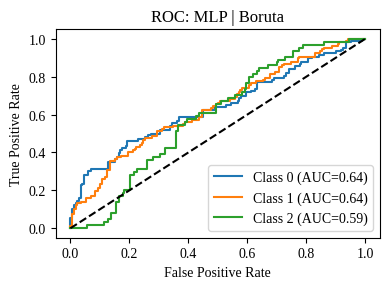

🔹 Swin-Tiny | layers_1_blocks_0 | RFE | SVM


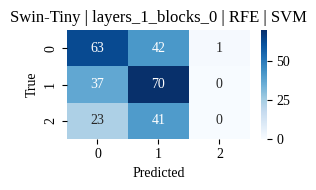

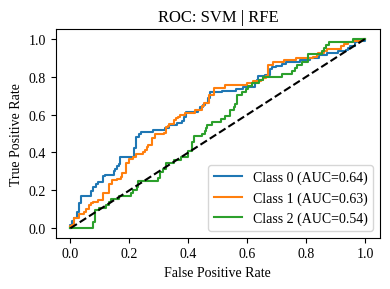

🔹 Swin-Tiny | layers_1_blocks_0 | RFE | RandomForest


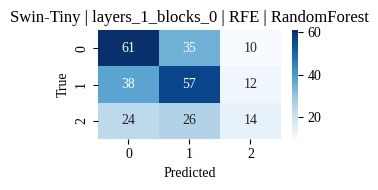

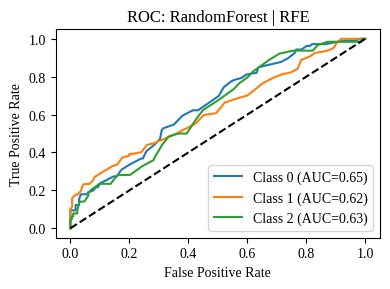

🔹 Swin-Tiny | layers_1_blocks_0 | RFE | LogisticRegression


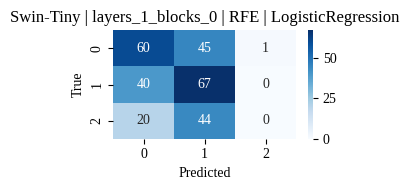

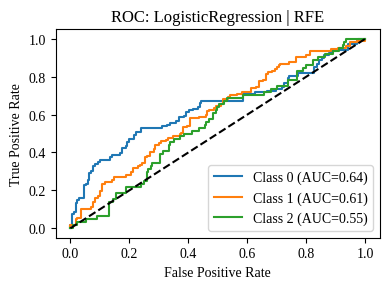

🔹 Swin-Tiny | layers_1_blocks_0 | RFE | KNN


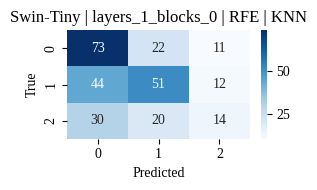

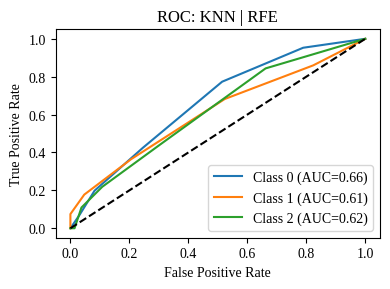

🔹 Swin-Tiny | layers_1_blocks_0 | RFE | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


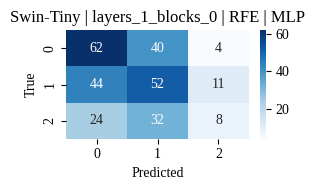

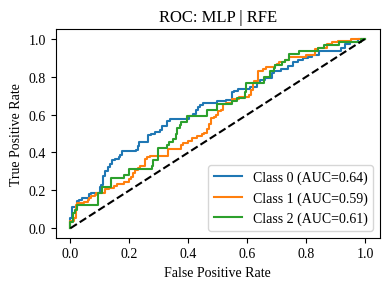

🔹 Swin-Tiny | layers_1_blocks_0 | ANOVA | SVM


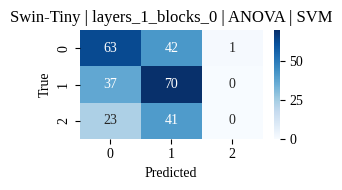

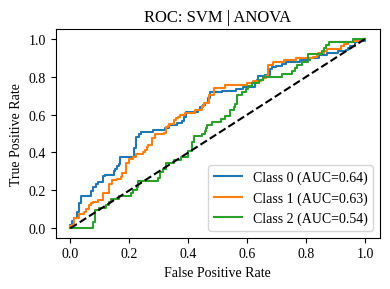

🔹 Swin-Tiny | layers_1_blocks_0 | ANOVA | RandomForest


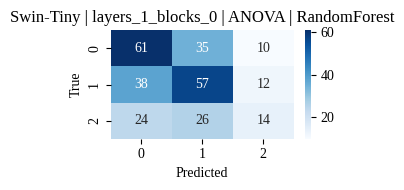

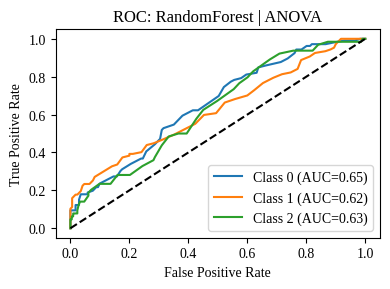

🔹 Swin-Tiny | layers_1_blocks_0 | ANOVA | LogisticRegression


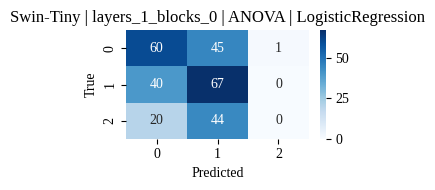

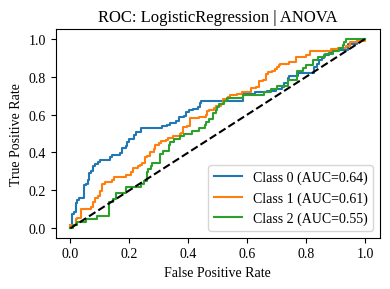

🔹 Swin-Tiny | layers_1_blocks_0 | ANOVA | KNN


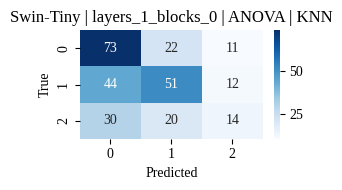

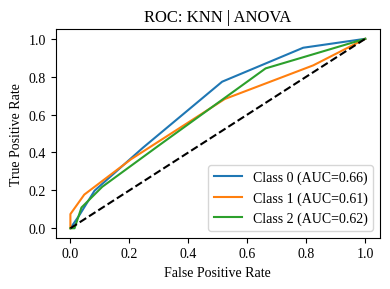

🔹 Swin-Tiny | layers_1_blocks_0 | ANOVA | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


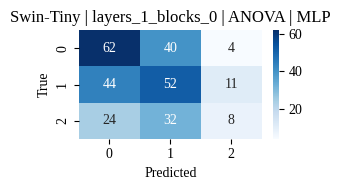

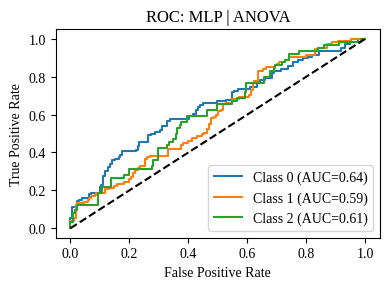

🔹 Swin-Tiny | layers_1_blocks_0 | Chi-Square | SVM


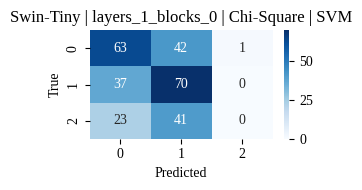

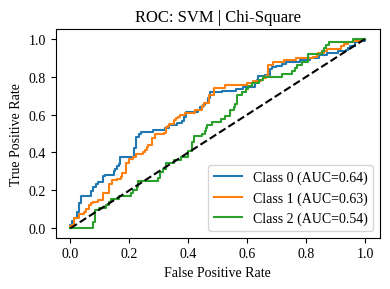

🔹 Swin-Tiny | layers_1_blocks_0 | Chi-Square | RandomForest


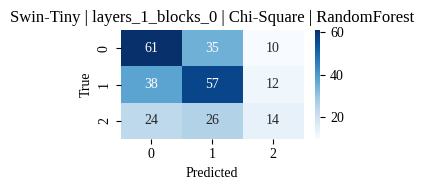

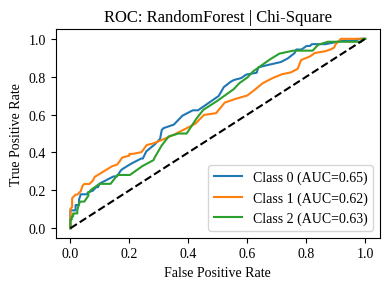

🔹 Swin-Tiny | layers_1_blocks_0 | Chi-Square | LogisticRegression


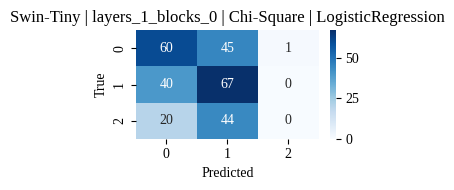

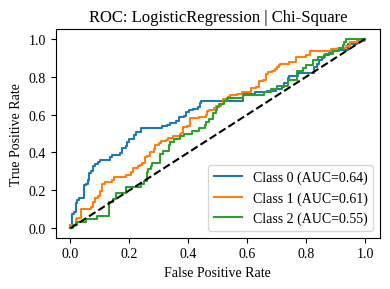

🔹 Swin-Tiny | layers_1_blocks_0 | Chi-Square | KNN


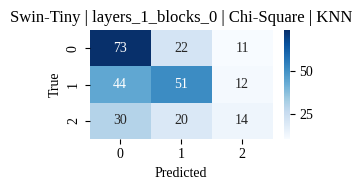

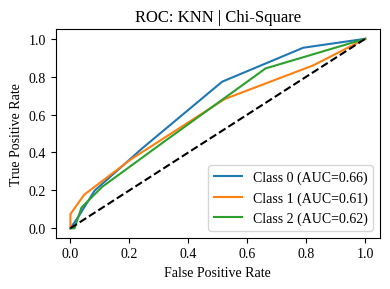

🔹 Swin-Tiny | layers_1_blocks_0 | Chi-Square | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


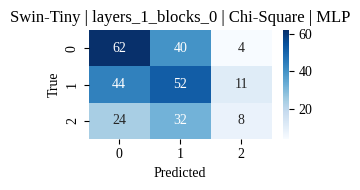

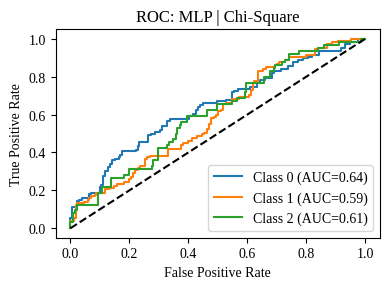

🔹 Swin-Tiny | layers_1_blocks_0 | Kruskal-Wallis | SVM


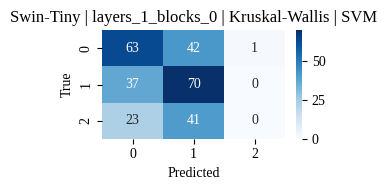

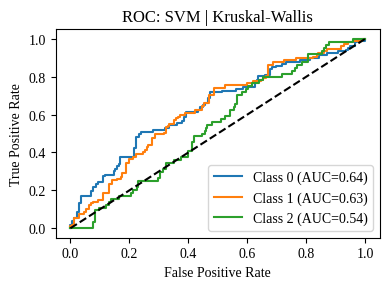

🔹 Swin-Tiny | layers_1_blocks_0 | Kruskal-Wallis | RandomForest


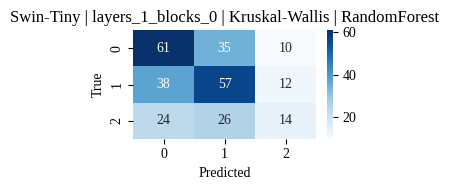

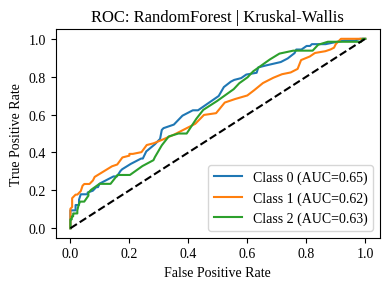

🔹 Swin-Tiny | layers_1_blocks_0 | Kruskal-Wallis | LogisticRegression


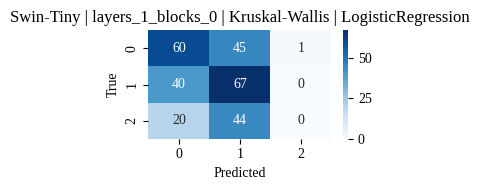

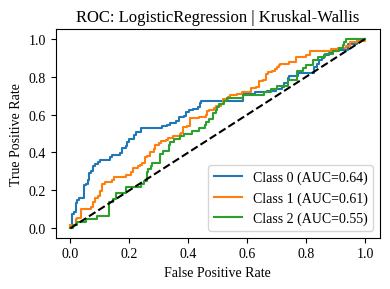

🔹 Swin-Tiny | layers_1_blocks_0 | Kruskal-Wallis | KNN


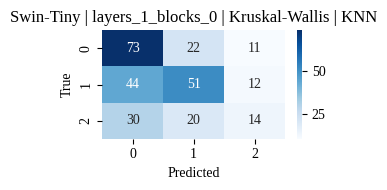

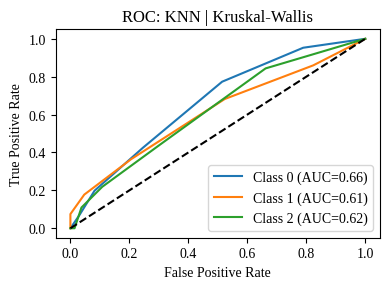

🔹 Swin-Tiny | layers_1_blocks_0 | Kruskal-Wallis | MLP


/home/pragya/.local/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


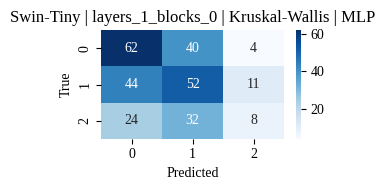

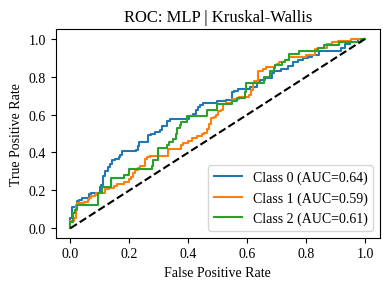

🔹 Swin-Tiny | layers_2_blocks_0 | Boruta | SVM


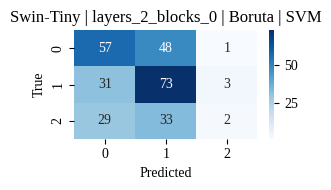

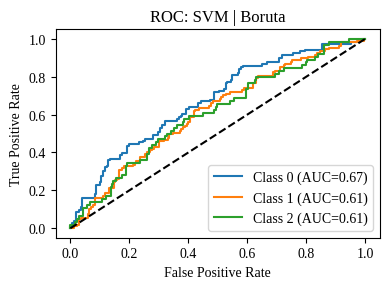

🔹 Swin-Tiny | layers_2_blocks_0 | Boruta | RandomForest


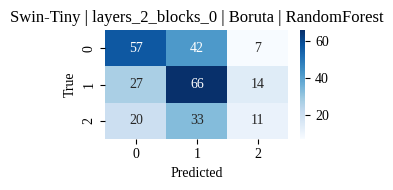

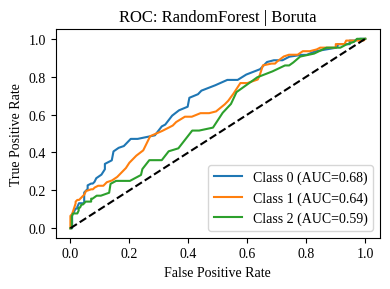

🔹 Swin-Tiny | layers_2_blocks_0 | Boruta | LogisticRegression


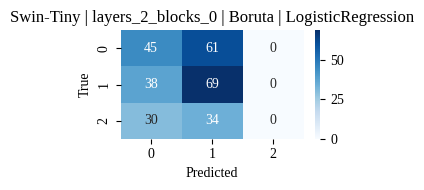

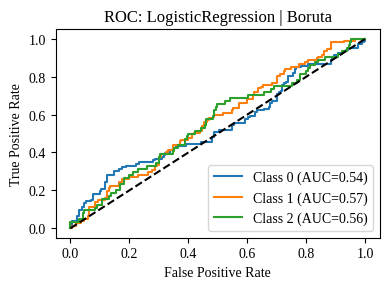

🔹 Swin-Tiny | layers_2_blocks_0 | Boruta | KNN


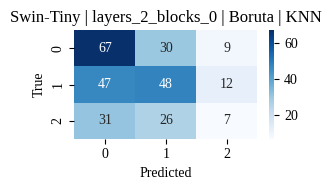

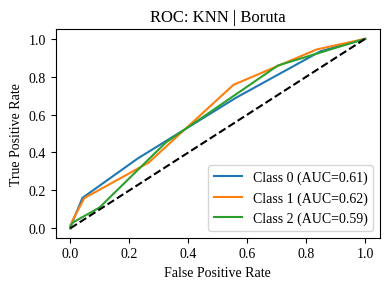

🔹 Swin-Tiny | layers_2_blocks_0 | Boruta | MLP


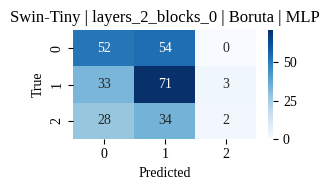

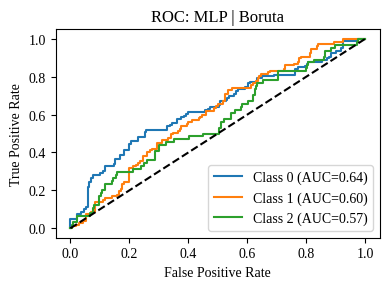

🔹 Swin-Tiny | layers_2_blocks_0 | RFE | SVM


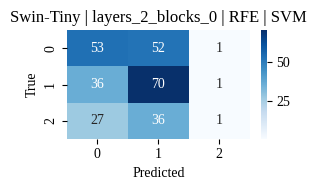

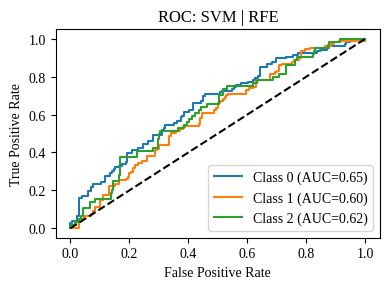

🔹 Swin-Tiny | layers_2_blocks_0 | RFE | RandomForest


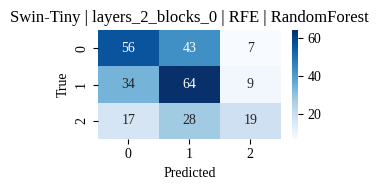

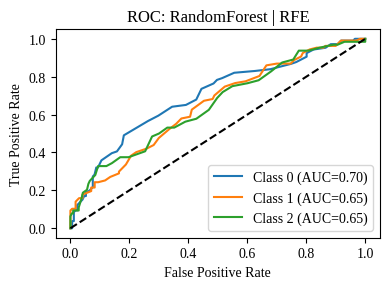

🔹 Swin-Tiny | layers_2_blocks_0 | RFE | LogisticRegression


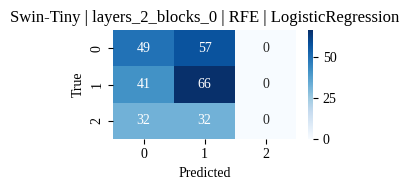

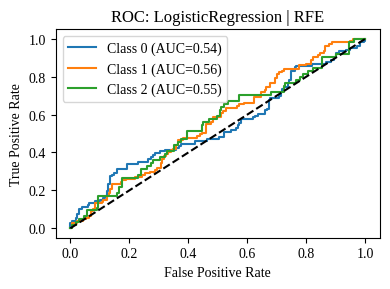

🔹 Swin-Tiny | layers_2_blocks_0 | RFE | KNN


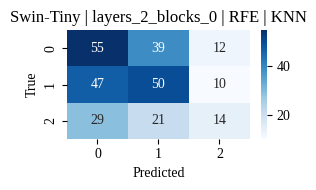

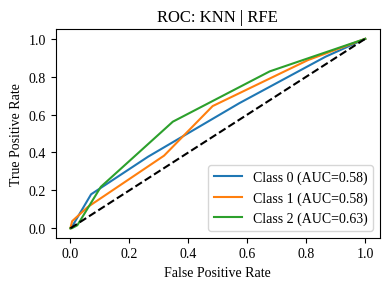

🔹 Swin-Tiny | layers_2_blocks_0 | RFE | MLP


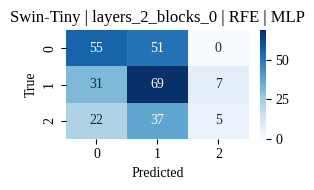

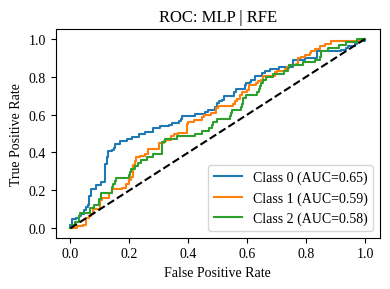

🔹 Swin-Tiny | layers_2_blocks_0 | ANOVA | SVM


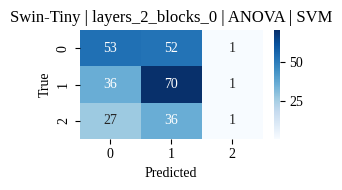

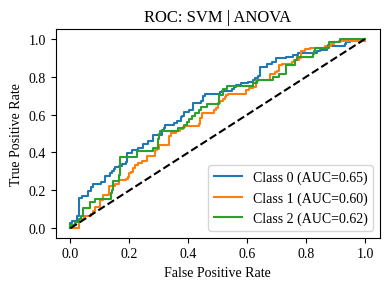

🔹 Swin-Tiny | layers_2_blocks_0 | ANOVA | RandomForest


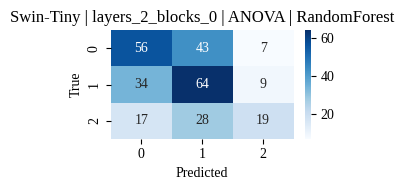

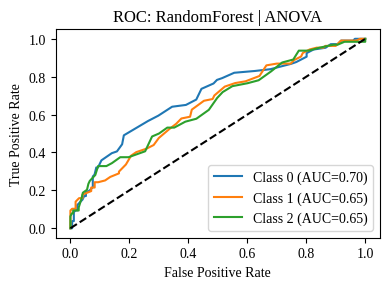

🔹 Swin-Tiny | layers_2_blocks_0 | ANOVA | LogisticRegression


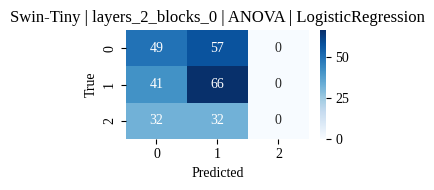

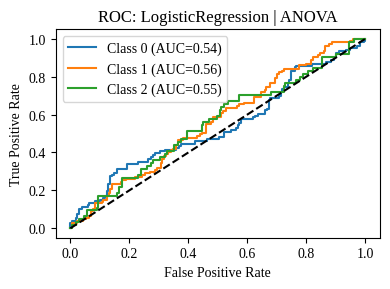

🔹 Swin-Tiny | layers_2_blocks_0 | ANOVA | KNN


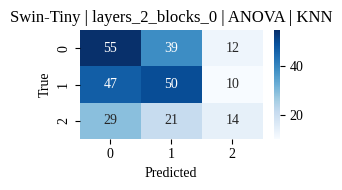

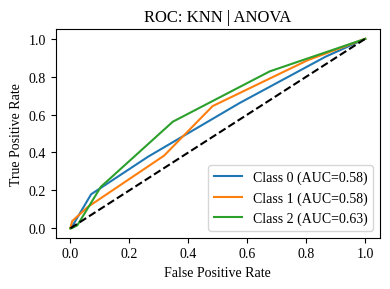

🔹 Swin-Tiny | layers_2_blocks_0 | ANOVA | MLP


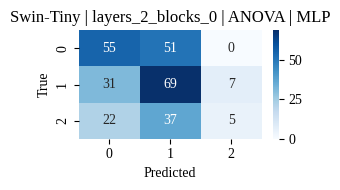

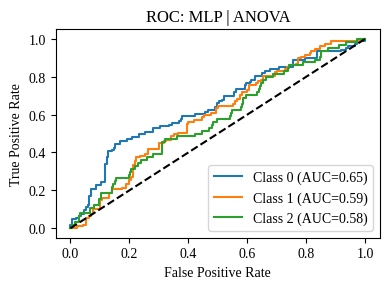

🔹 Swin-Tiny | layers_2_blocks_0 | Chi-Square | SVM


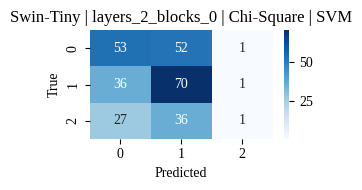

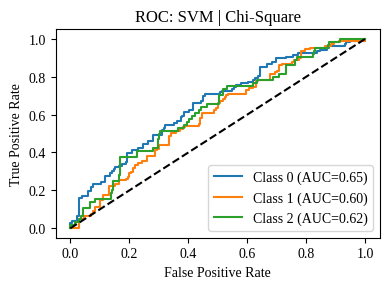

🔹 Swin-Tiny | layers_2_blocks_0 | Chi-Square | RandomForest


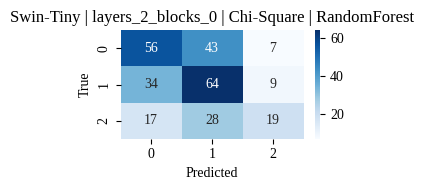

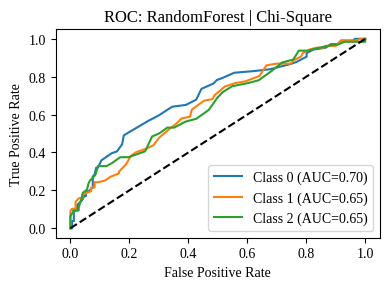

🔹 Swin-Tiny | layers_2_blocks_0 | Chi-Square | LogisticRegression


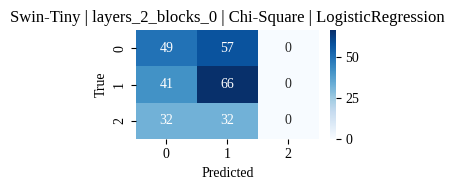

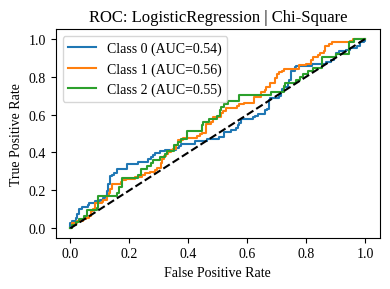

🔹 Swin-Tiny | layers_2_blocks_0 | Chi-Square | KNN


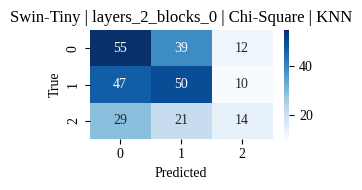

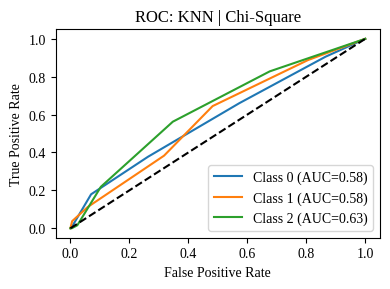

🔹 Swin-Tiny | layers_2_blocks_0 | Chi-Square | MLP


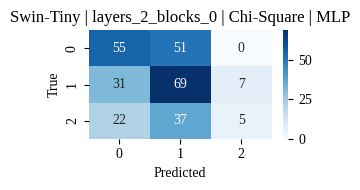

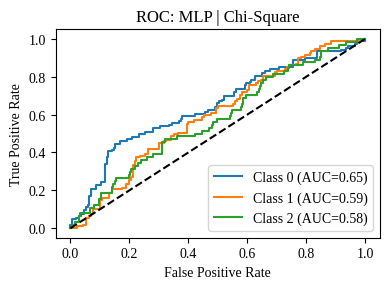

🔹 Swin-Tiny | layers_2_blocks_0 | Kruskal-Wallis | SVM


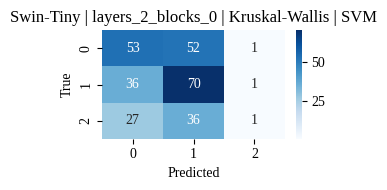

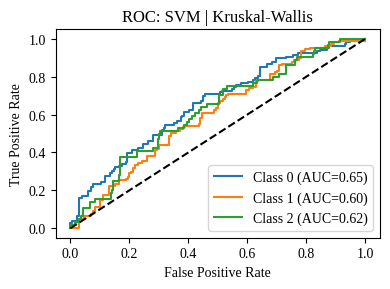

🔹 Swin-Tiny | layers_2_blocks_0 | Kruskal-Wallis | RandomForest


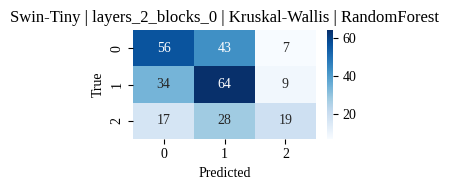

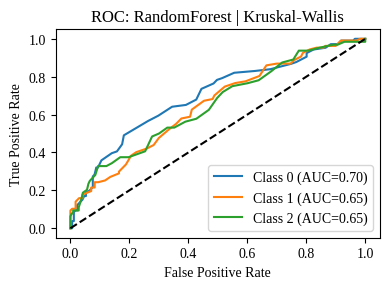

🔹 Swin-Tiny | layers_2_blocks_0 | Kruskal-Wallis | LogisticRegression


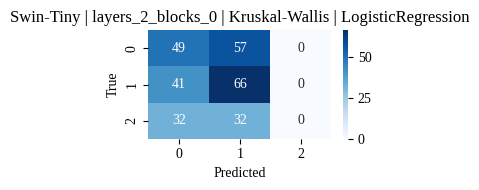

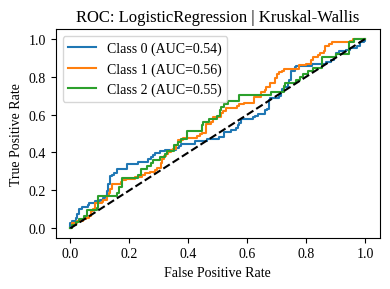

🔹 Swin-Tiny | layers_2_blocks_0 | Kruskal-Wallis | KNN


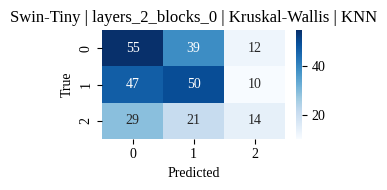

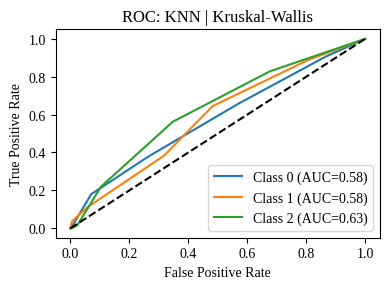

🔹 Swin-Tiny | layers_2_blocks_0 | Kruskal-Wallis | MLP


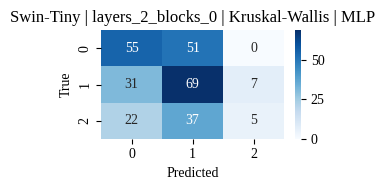

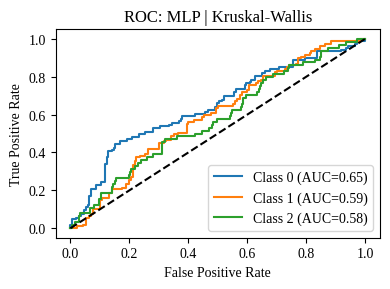

🔹 Swin-Tiny | layers_3_blocks_1 | Boruta | SVM


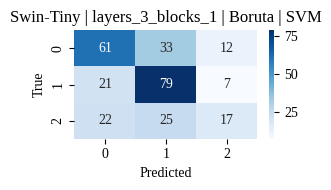

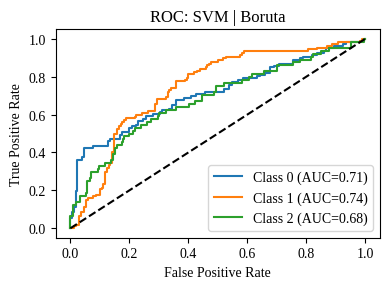

🔹 Swin-Tiny | layers_3_blocks_1 | Boruta | RandomForest


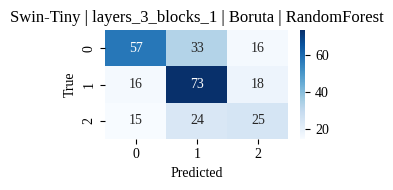

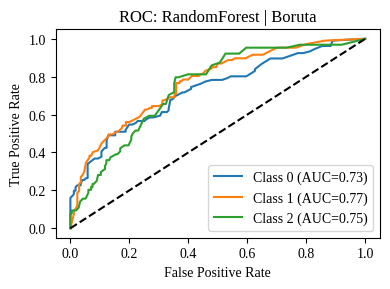

🔹 Swin-Tiny | layers_3_blocks_1 | Boruta | LogisticRegression


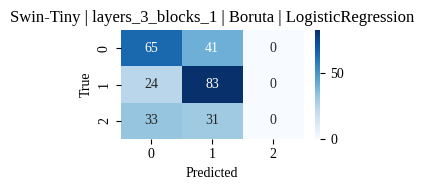

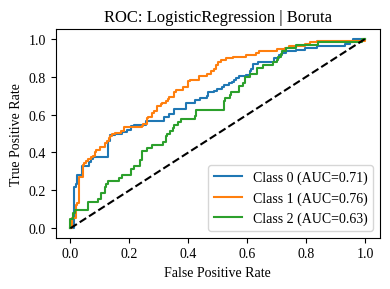

🔹 Swin-Tiny | layers_3_blocks_1 | Boruta | KNN


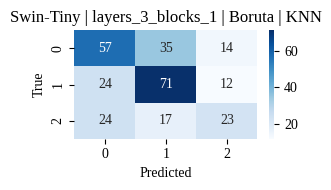

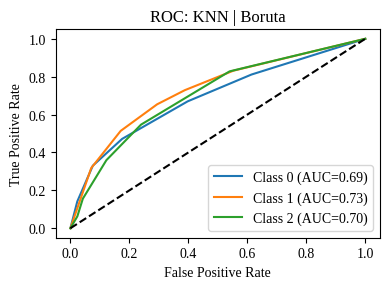

🔹 Swin-Tiny | layers_3_blocks_1 | Boruta | MLP


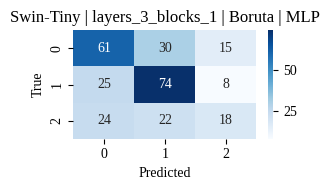

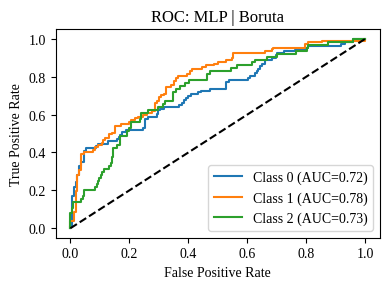

🔹 Swin-Tiny | layers_3_blocks_1 | RFE | SVM


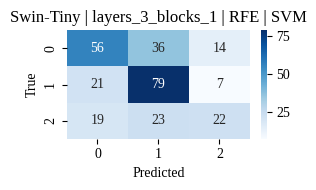

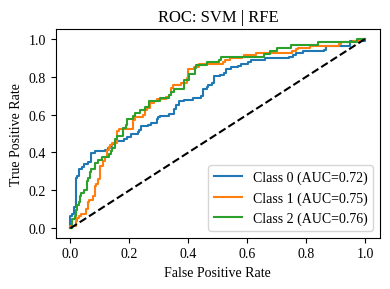

🔹 Swin-Tiny | layers_3_blocks_1 | RFE | RandomForest


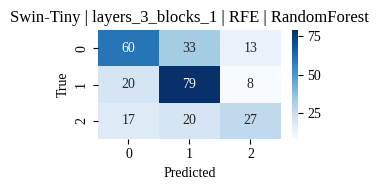

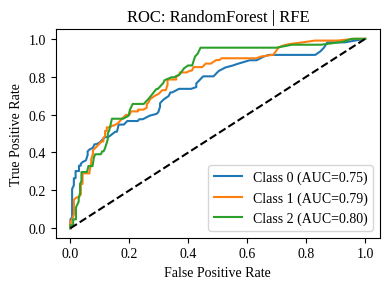

🔹 Swin-Tiny | layers_3_blocks_1 | RFE | LogisticRegression


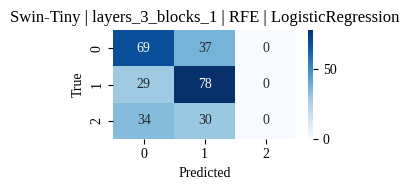

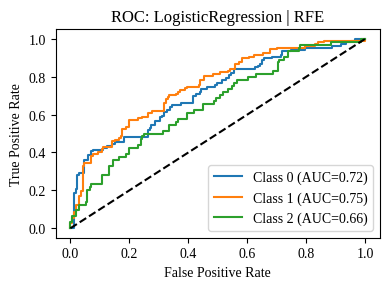

🔹 Swin-Tiny | layers_3_blocks_1 | RFE | KNN


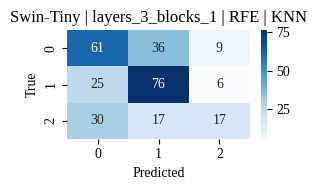

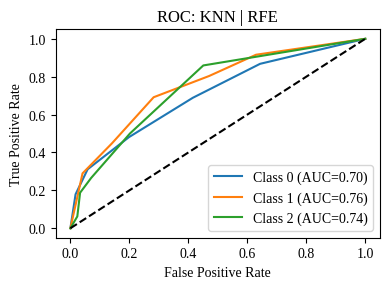

🔹 Swin-Tiny | layers_3_blocks_1 | RFE | MLP


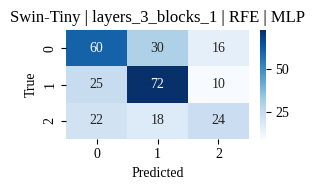

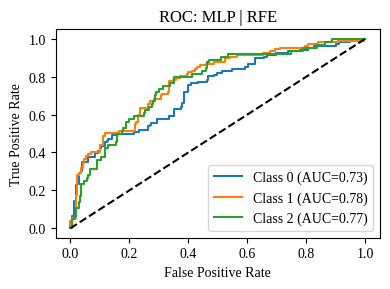

🔹 Swin-Tiny | layers_3_blocks_1 | ANOVA | SVM


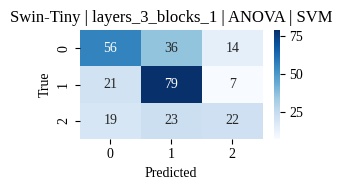

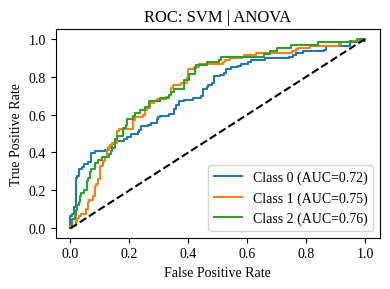

🔹 Swin-Tiny | layers_3_blocks_1 | ANOVA | RandomForest


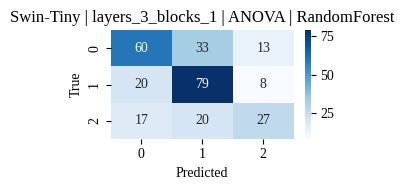

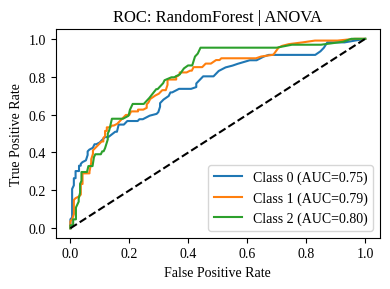

🔹 Swin-Tiny | layers_3_blocks_1 | ANOVA | LogisticRegression


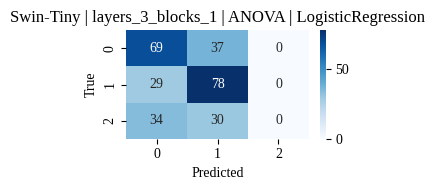

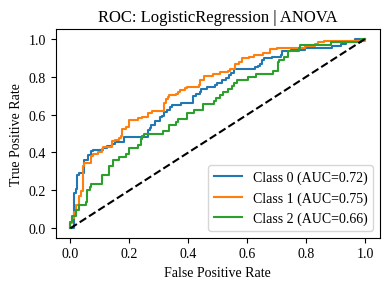

🔹 Swin-Tiny | layers_3_blocks_1 | ANOVA | KNN


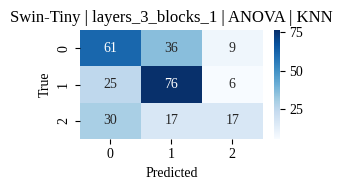

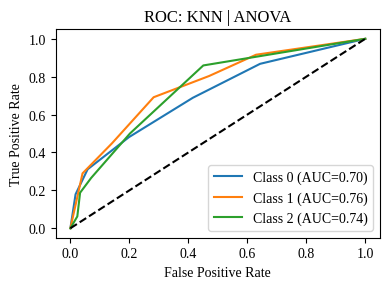

🔹 Swin-Tiny | layers_3_blocks_1 | ANOVA | MLP


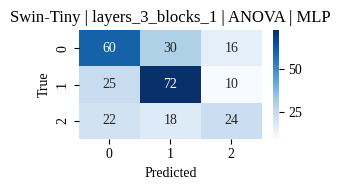

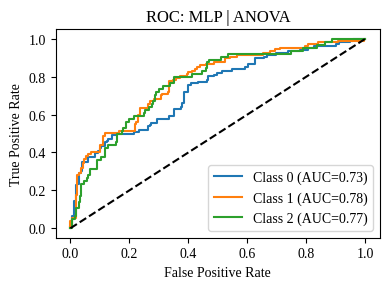

🔹 Swin-Tiny | layers_3_blocks_1 | Chi-Square | SVM


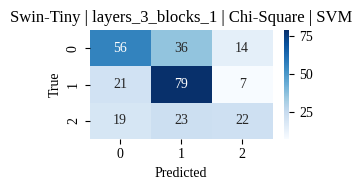

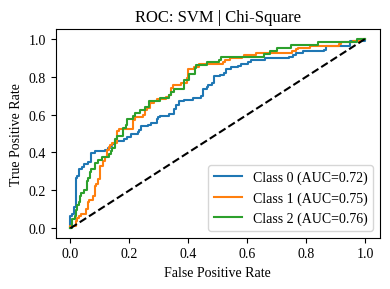

🔹 Swin-Tiny | layers_3_blocks_1 | Chi-Square | RandomForest


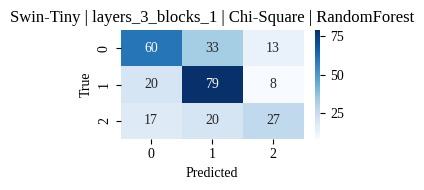

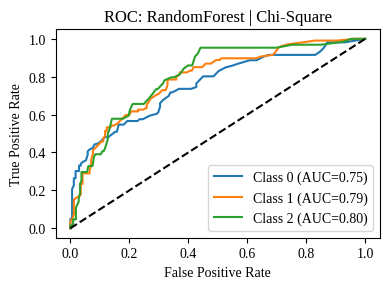

🔹 Swin-Tiny | layers_3_blocks_1 | Chi-Square | LogisticRegression


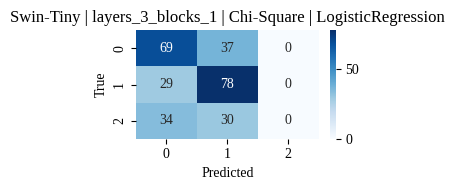

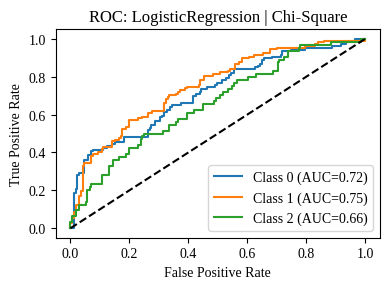

🔹 Swin-Tiny | layers_3_blocks_1 | Chi-Square | KNN


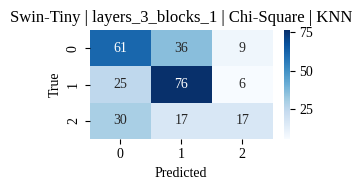

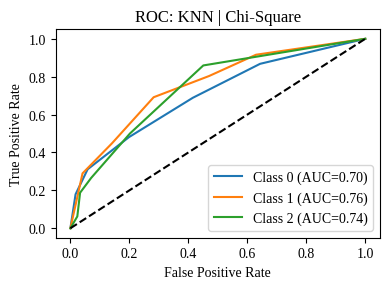

🔹 Swin-Tiny | layers_3_blocks_1 | Chi-Square | MLP


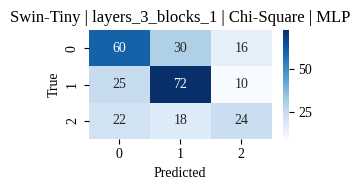

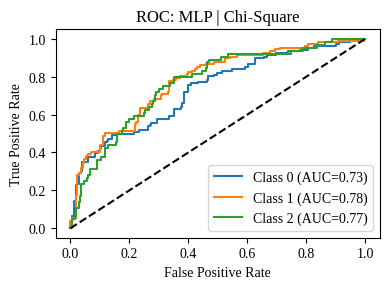

🔹 Swin-Tiny | layers_3_blocks_1 | Kruskal-Wallis | SVM


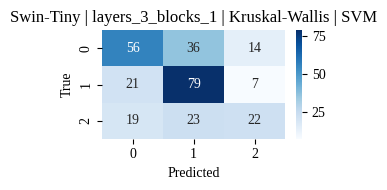

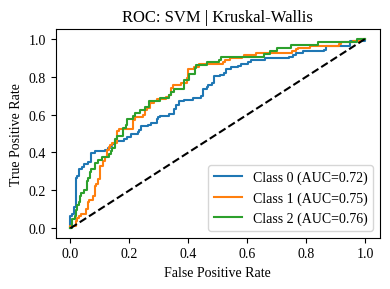

🔹 Swin-Tiny | layers_3_blocks_1 | Kruskal-Wallis | RandomForest


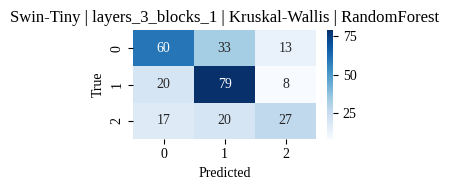

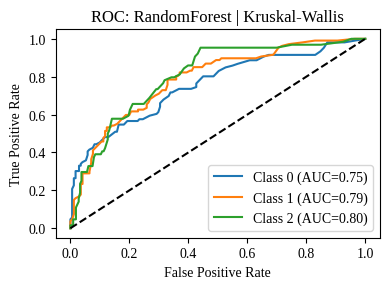

🔹 Swin-Tiny | layers_3_blocks_1 | Kruskal-Wallis | LogisticRegression


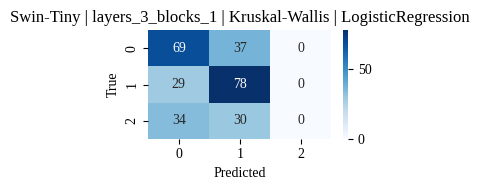

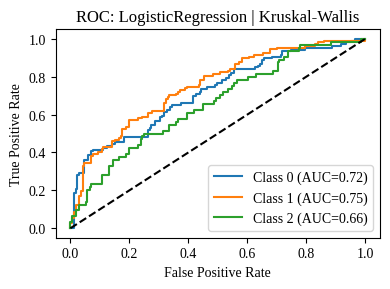

🔹 Swin-Tiny | layers_3_blocks_1 | Kruskal-Wallis | KNN


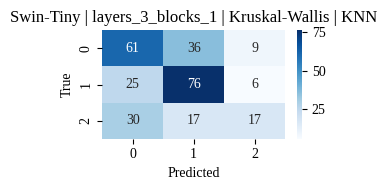

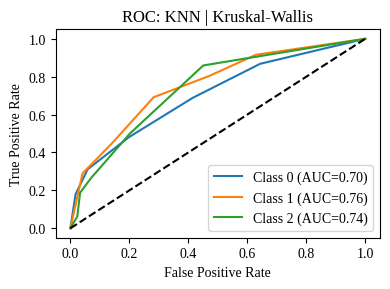

🔹 Swin-Tiny | layers_3_blocks_1 | Kruskal-Wallis | MLP


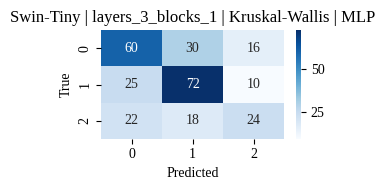

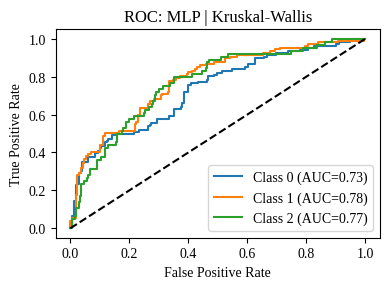

🔹 Swin-Tiny | norm | Boruta | SVM


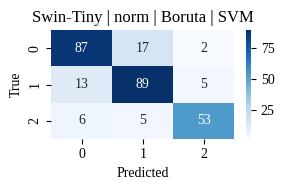

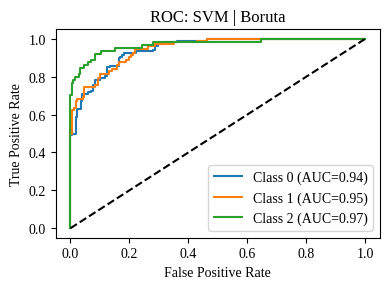

🔹 Swin-Tiny | norm | Boruta | RandomForest


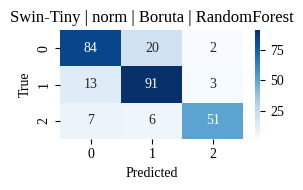

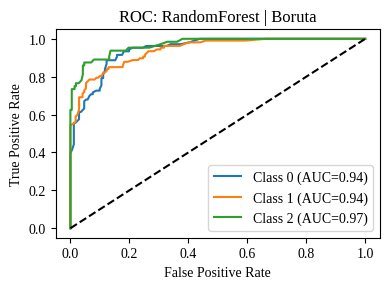

🔹 Swin-Tiny | norm | Boruta | LogisticRegression


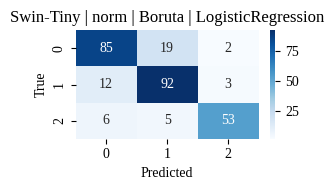

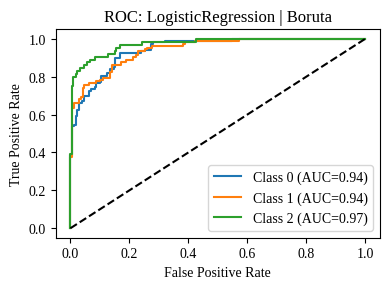

🔹 Swin-Tiny | norm | Boruta | KNN


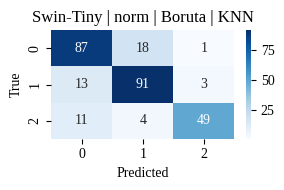

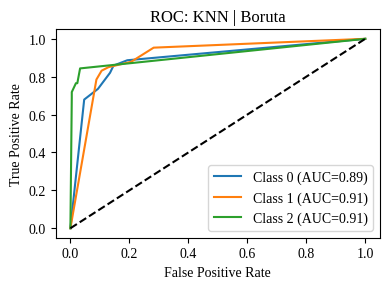

🔹 Swin-Tiny | norm | Boruta | MLP


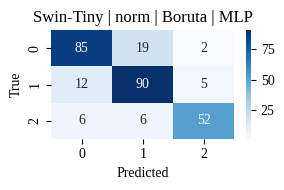

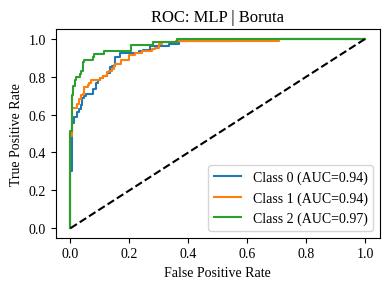

🔹 Swin-Tiny | norm | RFE | SVM


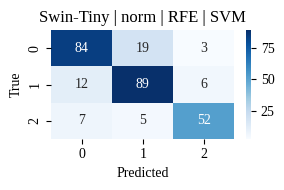

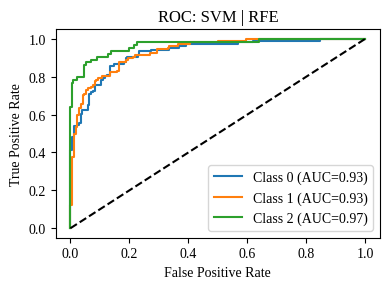

🔹 Swin-Tiny | norm | RFE | RandomForest


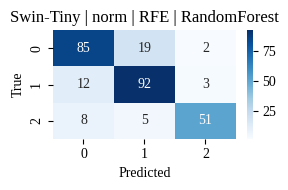

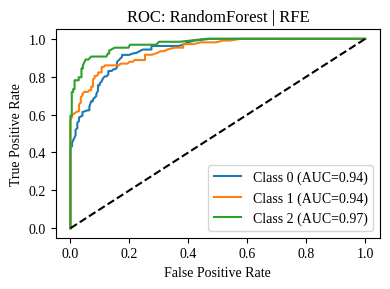

🔹 Swin-Tiny | norm | RFE | LogisticRegression


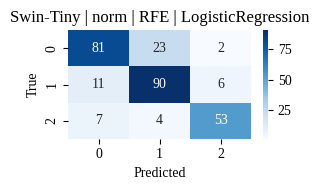

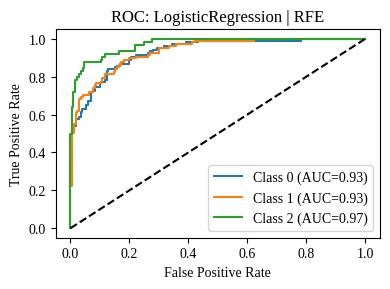

🔹 Swin-Tiny | norm | RFE | KNN


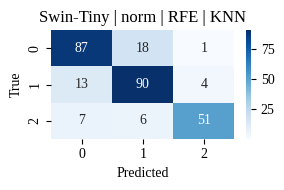

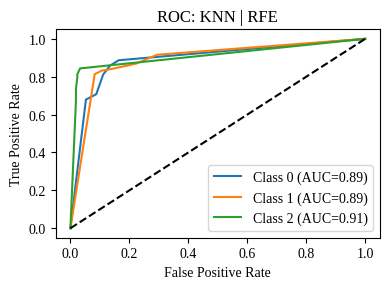

🔹 Swin-Tiny | norm | RFE | MLP


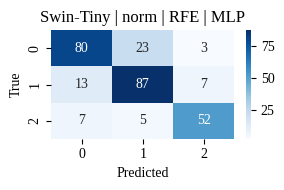

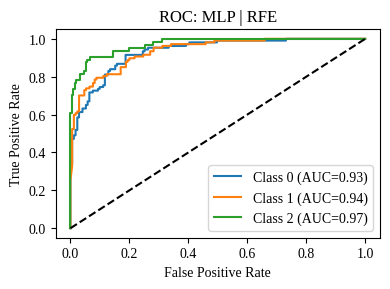

🔹 Swin-Tiny | norm | ANOVA | SVM


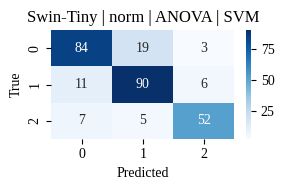

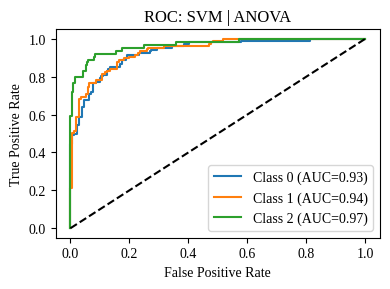

🔹 Swin-Tiny | norm | ANOVA | RandomForest


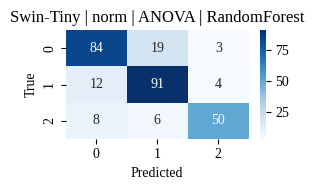

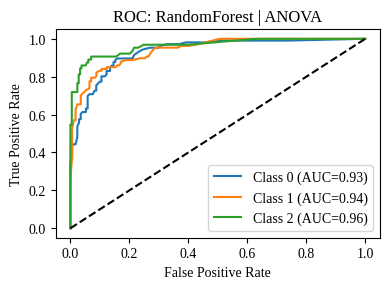

🔹 Swin-Tiny | norm | ANOVA | LogisticRegression


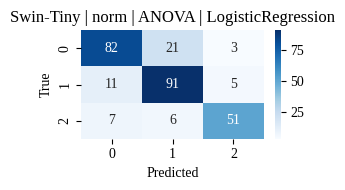

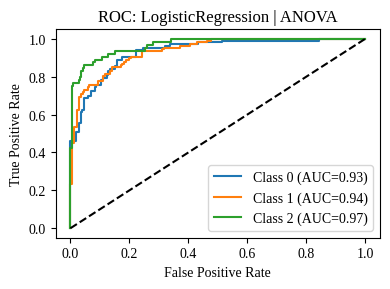

🔹 Swin-Tiny | norm | ANOVA | KNN


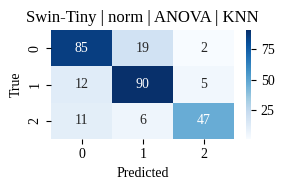

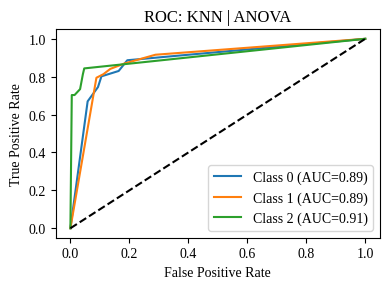

🔹 Swin-Tiny | norm | ANOVA | MLP


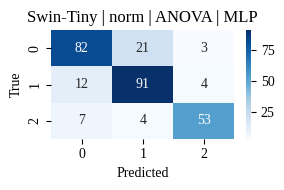

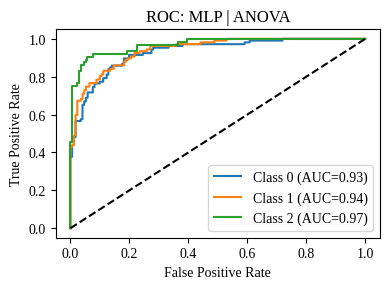

🔹 Swin-Tiny | norm | Chi-Square | SVM


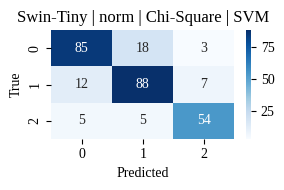

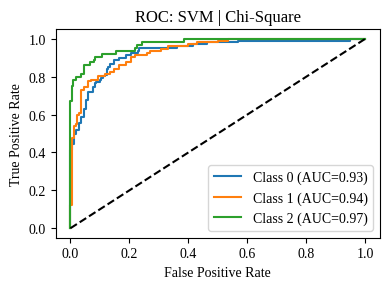

🔹 Swin-Tiny | norm | Chi-Square | RandomForest


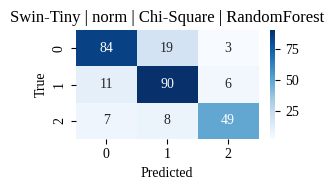

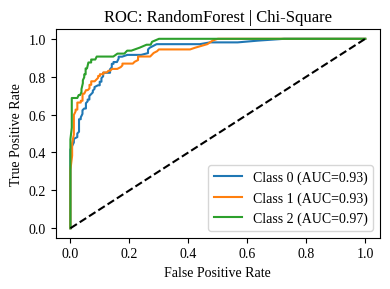

🔹 Swin-Tiny | norm | Chi-Square | LogisticRegression


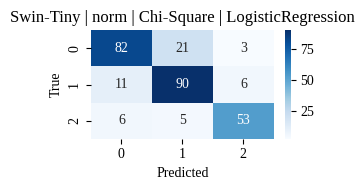

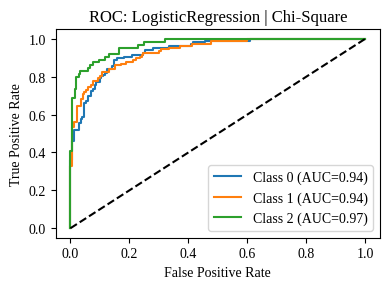

🔹 Swin-Tiny | norm | Chi-Square | KNN


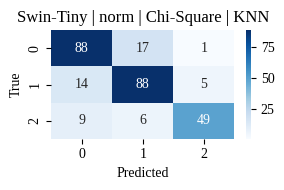

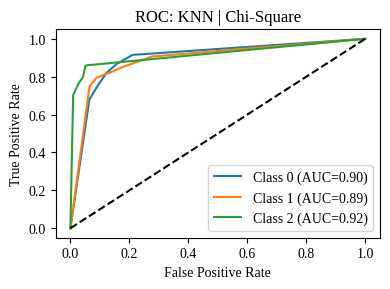

🔹 Swin-Tiny | norm | Chi-Square | MLP


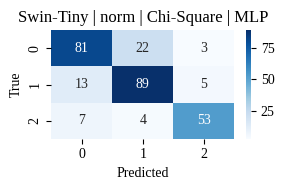

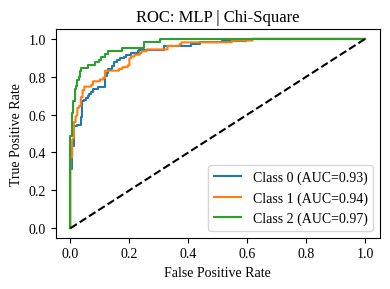

🔹 Swin-Tiny | norm | Kruskal-Wallis | SVM


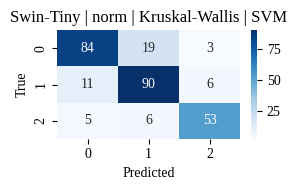

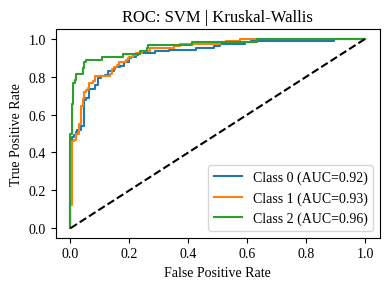

🔹 Swin-Tiny | norm | Kruskal-Wallis | RandomForest


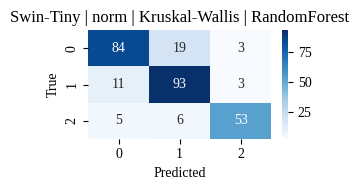

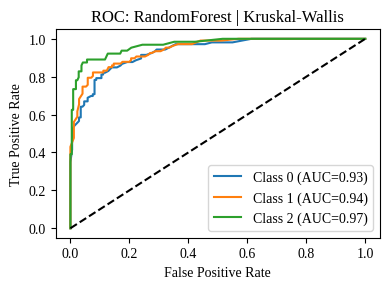

🔹 Swin-Tiny | norm | Kruskal-Wallis | LogisticRegression


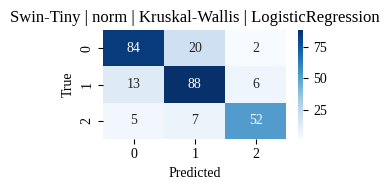

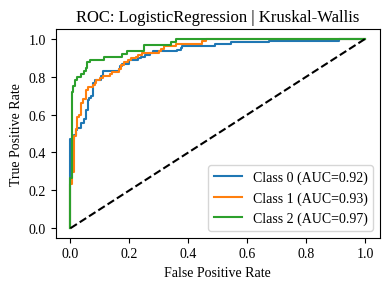

🔹 Swin-Tiny | norm | Kruskal-Wallis | KNN


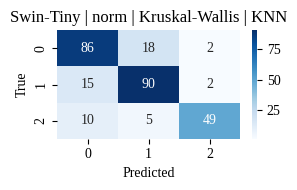

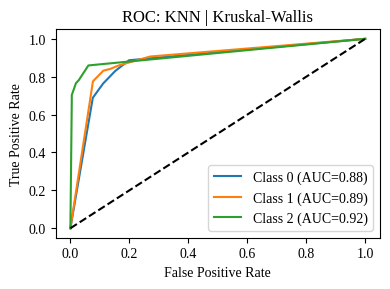

🔹 Swin-Tiny | norm | Kruskal-Wallis | MLP


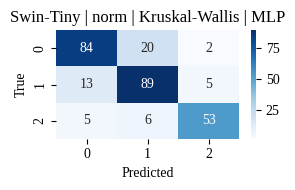

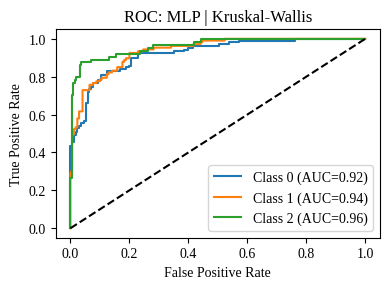


✅ Results saved to: /mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers/layerwise_model_results.csv
      Model   Layer Feature Selection          Classifier  Accuracy  \
0  ResNet50  layer1            Boruta                 SVM  0.617329   
1  ResNet50  layer1            Boruta        RandomForest  0.671480   
2  ResNet50  layer1            Boruta  LogisticRegression  0.545126   
3  ResNet50  layer1            Boruta                 KNN  0.631769   
4  ResNet50  layer1            Boruta                 MLP  0.660650   

   Precision    Recall  F1-Score   AUC-ROC  
0   0.676214  0.587447  0.599364  0.793991  
1   0.694911  0.650920  0.661775  0.837287  
2   0.577462  0.510226  0.513994  0.744678  
3   0.671824  0.603830  0.616759  0.789013  
4   0.669153  0.647648  0.655133  0.812012  


In [16]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    roc_auc_score, confusion_matrix, roc_curve, auc
)
from sklearn.preprocessing import label_binarize

# ✅ Define classifiers
models = {
    "SVM": SVC(kernel="rbf", probability=True, random_state=42),
    "RandomForest": RandomForestClassifier(n_estimators=100, random_state=42),
    "LogisticRegression": LogisticRegression(max_iter=1000, random_state=42),
    "KNN": KNeighborsClassifier(n_neighbors=5),
    "MLP": MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
}




SELECTION_METHODS = ["Boruta", "RFE", "ANOVA", "Chi-Square", "Kruskal-Wallis"]
BASE_DIR = "/mnt/c/Users/pragy/Downloads/Dataset/Original Images/Split_Dataset/Features_Same_Dataset/Layers" 
BACKBONES = ["swin_tiny_patch4_window7_224", "resnet50"]


LAYERS = {
    "resnet50": ["layer1", "layer2", "layer3", "layer4"],
    "swin_tiny_patch4_window7_224": [
        "layers_0_blocks_0", "layers_1_blocks_0", "layers_2_blocks_0", "layers_3_blocks_1", "norm"
    ]
}

SPLITS = ["train", "val", "test"]

# ✅ Collect results
all_results = []

for model, short_name in zip(MODELS, MODEL_SHORT_NAMES):
    for layer in LAYERS[model]:
        for method in SELECTION_METHODS:
            try:
                # Load feature files
                X_train = np.load(os.path.join(BASE_DIR, f"{model}_train_{layer}_{method}.npy"))
                X_val   = np.load(os.path.join(BASE_DIR, f"{model}_val_{layer}_{method}.npy"))
                X_test  = np.load(os.path.join(BASE_DIR, f"{model}_test_{layer}_{method}.npy"))

                y_train = np.load(os.path.join(BASE_DIR, f"{model}_train_labels.npy")).astype(int)
                y_val   = np.load(os.path.join(BASE_DIR, f"{model}_val_labels.npy")).astype(int)
                y_test  = np.load(os.path.join(BASE_DIR, f"{model}_test_labels.npy")).astype(int)

            except FileNotFoundError as e:
                print(f"⚠️ Missing file: {e.filename}. Skipping...")
                continue

            for clf_name, clf in models.items():
                print(f"🔹 {short_name} | {layer} | {method} | {clf_name}")

                clf.fit(X_train, y_train)
                y_pred = clf.predict(X_test)
                y_prob = clf.predict_proba(X_test) if hasattr(clf, "predict_proba") else None

                acc = accuracy_score(y_test, y_pred)
                prec = precision_score(y_test, y_pred, average="macro", zero_division=0)
                rec = recall_score(y_test, y_pred, average="macro", zero_division=0)
                f1 = f1_score(y_test, y_pred, average="macro", zero_division=0)
                auc_roc = roc_auc_score(y_test, y_prob, multi_class="ovr") if y_prob is not None else "N/A"

                all_results.append([
                    short_name, layer, method, clf_name, acc, prec, rec, f1, auc_roc
                ])

                # Plot Confusion Matrix
                cm = confusion_matrix(y_test, y_pred)
                plt.figure(figsize=(3, 2))
                sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
                plt.title(f"{short_name} | {layer} | {method} | {clf_name}")
                plt.xlabel("Predicted")
                plt.ylabel("True")
                plt.tight_layout()
                plt.show()

                # Plot ROC Curve
                if y_prob is not None:
                    y_bin = label_binarize(y_test, classes=np.unique(y_test))
                    plt.figure(figsize=(4, 3))
                    for i in range(y_bin.shape[1]):
                        fpr, tpr, _ = roc_curve(y_bin[:, i], y_prob[:, i])
                        roc_auc = auc(fpr, tpr)
                        plt.plot(fpr, tpr, label=f"Class {i} (AUC={roc_auc:.2f})")
                    plt.plot([0, 1], [0, 1], "k--")
                    plt.xlabel("False Positive Rate")
                    plt.ylabel("True Positive Rate")
                    plt.title(f"ROC: {clf_name} | {method}")
                    plt.legend()
                    plt.tight_layout()
                    plt.show()

# ✅ Save to CSV
df_results = pd.DataFrame(all_results, columns=[
    "Model", "Layer", "Feature Selection", "Classifier",
    "Accuracy", "Precision", "Recall", "F1-Score", "AUC-ROC"
])
csv_path = os.path.join(BASE_DIR, "layerwise_model_results.csv")
df_results.to_csv(csv_path, index=False)

print(f"\n✅ Results saved to: {csv_path}")
print(df_results.head())
